# Project: Advanced Lane Finding

## Camera calibration

In [4]:
import os
import math
import time
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import pickle

# HYPERPARAMETERS
# Choose the number of sliding windows
nwindows = 9
# Set the width of the windows +/- margin
margin = 100
# Set minimum number of pixels found to recenter window
minpix = 50

camera_cal_images = []
def camera_cal():
    # prepare object points
    nx = 9 #TODO: enter the number of inside corners in x
    ny = 6 #TODO: enter the number of inside corners in y
    winSize = (nx, ny)
    count = 0

    # nx*ny object points,  (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
    objp = np.zeros((nx*ny,3), np.float32)
    objp[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape(-1,2)

    # Arrays to store object points and image points from all the images.
    objpoints = [] # points in real world space, 3d 
    imgpoints = [] # points in image plane, 2d

    # Make a list of calibration images
    os.listdir("camera_cal/")
    for filename in os.listdir("camera_cal/"):
        image = mpimg.imread("camera_cal/"+filename)
        camera_cal_images.append(image)
        if count==0:
            img_size = (image.shape[1], image.shape[0])
        gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

        # Find the chessboard corners
        ret, corners = cv2.findChessboardCorners(gray, winSize, None)       
        if ret == True:
            criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)
            cv2.cornerSubPix(gray, corners, winSize, (-1,-1), criteria)
            # save for calibration
            objpoints.append(objp)
            imgpoints.append(corners)
            
            # Draw and display corners
            cv2.drawChessboardCorners(image, winSize, corners, ret)
            # plt.imshow(image)
            count += 1
        time.sleep(0.1)    
    #print("succesed", count)
    # Apply calibration 
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size, None, None)
    # Save the camera calibration result for later use (we won't worry about rvecs / tvecs)
    print('calibrated!')
    dist_pickle = {}
    dist_pickle["mtx"] = mtx
    dist_pickle["dist"] = dist
    dist_pickle["rvecs"] = rvecs
    dist_pickle["tvecs"] = tvecs
    file = open('camera_calib_matrix.dat', 'wb')
    pickle.dump( dist_pickle, file )
    file.close()                
    return True, mtx, dist, rvecs, tvecs

def undist(image, mtx, dist, rvecs, tvecs, bWrite=False):
    undist_img = cv2.undistort(image, mtx, dist, None, mtx)
    if bWrite==True:
        cv2.imwrite('output_images/test_undist.jpg',undist_img)
    return undist_img    

file = open( "camera_calib_matrix.dat", "rb" ) 
dist_pickle = pickle.load( file )
mtx = dist_pickle["mtx"]
dist = dist_pickle["dist"]
#rvecs = dist_pickle["rvecs"]
#tvecs = dist_pickle["tvecs"]
#print(mtx,dist,rvecs,tvecs)
file.close()    

def perspective_image(image):
    return image

# calibrate camera from images
ret, mtx, dist, rvecs, tvecs = camera_cal()
print(ret)

calibrated!
True


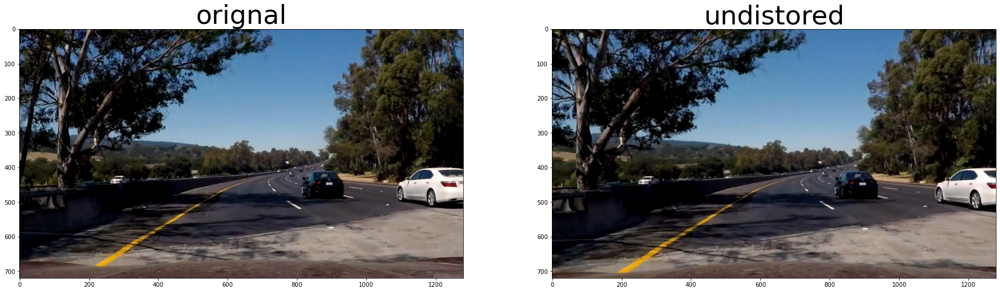

In [5]:
# if success, undistort a sample image and show
if 0:
    if ret==True:
        undist_image = undist(camera_cal_images[0], mtx, dist, rvecs, tvecs, False)
    fig, (ax1, ax2) = plt.subplots(1,2,figsize=(30,24))
    ax1.imshow(camera_cal_images[0])
    ax1.set_title("orignal", fontsize=45)
    ax2.imshow(undist_image)
    ax2.set_title("undistored", fontsize=45)
else:
    # Read in an image and grayscale it
    test_images = [mpimg.imread('test_images/' + i) for i in os.listdir('test_images/')]
    image = test_images[0]
    if ret==True:
        undist_image = undist(image, mtx, dist, rvecs, tvecs, False)
        cv2.imwrite('output_images/RoadTransformed.png',undist_image)
        fig, (ax1, ax2) = plt.subplots(1,2,figsize=(30,24))
        ax1.imshow(image)
        ax1.set_title("orignal", fontsize=45)
        ax2.imshow(undist_image)
        ax2.set_title("undistored", fontsize=45)
    

# different way to extract edge from image 

In [6]:
# Sobel function for edge of x or y, 
def abs_sobel_thresh(img, orient='x', sobel_kernel=3, thresh=(0, 255)):
    
    # Apply the following steps to img
    # 1) Convert to grayscale
    if img.ndim==2:
        gray = img
    else:    
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
        
    # 2) Take the derivative in x or y given orient = 'x' or 'y'
    if orient=='x':
        sobel = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    else:    
        sobel = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # 3) Take the absolute value of the derivative or gradient
    abs_sobel = np.absolute(sobel)
    # 4) Scale to 8-bit (0 - 255) then convert to type = np.uint8
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    
    # 5) Create a mask of 1's where the scaled gradient magnitude 
            # is > thresh_min and < thresh_max
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel>thresh[0]) & (scaled_sobel<=thresh[1])] = 1
    # 6) Return this mask as your binary_output image
    return binary_output

# magnide edge based on sobel
def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    
    # Apply the following steps to img
    # 1) Convert to grayscale
    if img.ndim==2:
        gray = img
    else:    
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # 2) Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # 3) Calculate the magnitude 
    mag_sobelx = cv2.multiply(sobelx, sobelx)
    mag_sobely = cv2.multiply(sobely, sobely)
    mag_sobel = cv2.sqrt(mag_sobelx+mag_sobely)
    # 4) Scale to 8-bit (0 - 255) and convert to type = np.uint8
    sobel_img = np.uint8(255*mag_sobel/np.max(mag_sobel))
    # 5) Create a mask of 1's where the scaled gradient magnitude 
            # is > thresh_min and < thresh_max
    sbinary = np.zeros_like(sobel_img)
    sbinary[(sobel_img>=mag_thresh[0]) & (sobel_img<=mag_thresh[1])] = 1
    # 6) Return this mask as your binary_output image
    binary_output = sbinary
    return binary_output

# edge by direction on sobel
def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    
    # Apply the following steps to img
    # 1) Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # 2) Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # 3) Take the absolute value of the x and y gradients
    abs_sobelx = np.absolute(sobelx)
    abs_sobely = np.absolute(sobely)
    # 4) Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient 
    sobel_direction = np.arctan2(abs_sobely, abs_sobelx)
    # 5) Create a binary mask where direction thresholds are met
    sbinary = np.zeros_like(sobel_direction)
    sbinary[(sobel_direction>=thresh[0]) & (sobel_direction<=thresh[1])] = 1
    # 6) Return this mask as your binary_output image
    binary_output = sbinary # Remove this line
    return binary_output

# lane thresh from color space
def hls_select(img, thresh=(0, 255)):
    # 1) Convert to HLS color space
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    # 2) Apply a threshold to the S channel
    h, l, s = cv2.split(hls)
    binary_output = np.zeros_like(s)
    binary_output[(s > thresh[0]) & (s <= thresh[1])] = 1
    # 3) Return a binary image of threshold result
    return binary_output

# define detect function to combined all together
def get_combined(image, ksize):
    gradx = abs_sobel_thresh(image, orient='x', sobel_kernel=ksize, thresh=(20, 100))  # sobel on x
    grady = abs_sobel_thresh(image, orient='y', sobel_kernel=ksize, thresh=(20, 100))  # sobel on y
    grad_sobel = (gradx==1) & (grady==1)  # sobel together
    mag_binary = mag_thresh(image, sobel_kernel=ksize, mag_thresh=(30, 100)) # mag
    dir_binary = dir_threshold(image, sobel_kernel=ksize, thresh=(0.7, 1.3)) # direction
    hls_binary = hls_select(image, thresh=(90, 255))  # on HLS color
    
    combined = np.zeros_like(dir_binary)
    combined[(grad_sobel==1) | (hls_binary==1) | ((mag_binary == 1) & (dir_binary == 1))] = 1
    return combined

# only combine without direction
def get_combined2(image, ksize):
    gradx = abs_sobel_thresh(image, orient='x', sobel_kernel=ksize, thresh=(20, 100))  # sobel on x
    grady = abs_sobel_thresh(image, orient='y', sobel_kernel=ksize, thresh=(20, 100))  # sobel on y
    grad_sobel = (gradx==1) & (grady==1)  # sobel together
    mag_binary = mag_thresh(image, sobel_kernel=ksize, mag_thresh=(30, 100)) # mag
    dir_binary = dir_threshold(image, sobel_kernel=ksize, thresh=(0.7, 1.3)) # direction
    hls_binary = hls_select(image, thresh=(90, 255))  # on HLS color
    
    combined = np.zeros_like(dir_binary)
    combined[(grad_sobel==1) | (hls_binary==1) | ((mag_binary == 1))] = 1
    return combined

# combind different edge images together

True

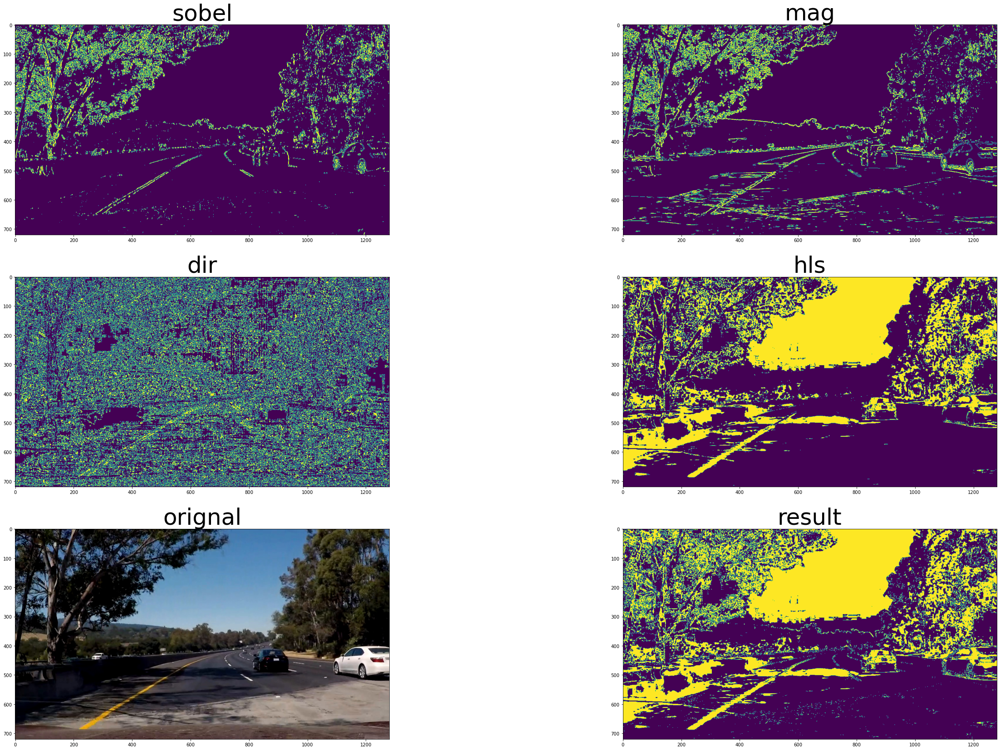

In [7]:
# test on image    
# Choose a Sobel kernel size
ksize = 3 # Choose a larger odd number to smooth gradient measurements

image = test_images[0]

# Apply each of the thresholding functions
gradx = abs_sobel_thresh(image, orient='x', sobel_kernel=ksize, thresh=(20, 100))  # sobel on x
grady = abs_sobel_thresh(image, orient='y', sobel_kernel=ksize, thresh=(20, 100))  # sobel on y
grad_sobel = (gradx==1) & (grady==1)  # sobel together
mag_binary = mag_thresh(image, sobel_kernel=ksize, mag_thresh=(30, 100)) # mag
dir_binary = dir_threshold(image, sobel_kernel=ksize, thresh=(0.7, 1.3)) # direction
hls_binary = hls_select(image, thresh=(90, 255))  # on HLS color

f, ((ax1, ax2), (ax3, ax4), (ax5, ax6)) = plt.subplots(3, 2, figsize=(44, 29))
ax1.imshow(gradx)
ax1.set_title('sobel', fontsize=50)
ax2.imshow(mag_binary)
ax2.set_title("mag", fontsize=50)
ax3.imshow(dir_binary)
ax3.set_title("dir", fontsize=50)
ax4.imshow(hls_binary)
ax4.set_title('hls', fontsize=50)

combined = np.zeros_like(dir_binary)
combined[(grad_sobel==1) | (hls_binary==1) | ((mag_binary == 1) & (dir_binary == 1))] = 1
ax5.imshow(image)
ax5.set_title("orignal", fontsize=50)
ax6.imshow(combined)
ax6.set_title("result", fontsize=50)

result = np.dstack(( combined, combined, combined)) * 255
cv2.imwrite("output_images/combined_test.jpg", result)

# warp image by perspective

In [61]:
# region function from previsous chapter
def region_of_interest(img, vertices):
    #defining a blank mask to start with
    mask = np.zeros_like(img)   
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image

# Defining vertices for marked area定义感兴趣区域,将左右两条车道线的区域框出来
def get_lane_mask(image):   
    imshape = image.shape
    #     print(imshape)
    left_bottom = (200, imshape[0])
    right_bottom = (imshape[1]-20, imshape[0])
    apex1 = (610, 470)
    apex2 = (660, 470)
    inner_left_bottom = (400, imshape[0])
    inner_right_bottom = (1020, imshape[0])
    inner_apex1 = (660,490)
    inner_apex2 = (650,490)
    vertices = np.array([[left_bottom, apex1, apex2, \
                          right_bottom, inner_right_bottom, \
                          inner_apex1, inner_apex2, inner_left_bottom]], dtype=np.int32)
    # Masked area
    color_binary = region_of_interest(image, vertices)
    return color_binary

# warp image
def warp_by_perspective(image, src_pt = [], dst_pt = [], showline=False):

    img_size = (image.shape[1],image.shape[0])
    w, h = image.shape[1],image.shape[0]
    # print(img_size)
    # set source and destination points value
    if len(src_pt)==0:
        src_pt = ([0, h-10], [548, 458], [732, 458], [w, h-10])
    if len(dst_pt):
        dst_pt = ([0, h], [0, 0], [w, 0], [w, h])

    # draw source and destination point on image
    if showline==True:
        pre = src_pt[0]
        for pt in dst_pt:
            cv2.line(image, (pre[0],pre[1]), (pt[0],pt[1]), (0, 255, 0), 5)
            pre = pt

        pre = dst_pt[0]
        for pt in src_pt:
            cv2.line(image, (pre[0],pre[1]), (pt[0],pt[1]), (0, 0, 255), 5)
            pre = pt

    src = np.float32(src_pt)
    dst = np.float32(dst_pt)
    # calculate transform matrix for perspective 
    Mper = cv2.getPerspectiveTransform(src, dst) #perspection matrix
    Mper_inv = cv2.getPerspectiveTransform(dst, src) #inverse matrix
    # Warp the image
    warped = cv2.warpPerspective(image, Mper, img_size)
    return warped, Mper, Mper_inv

True

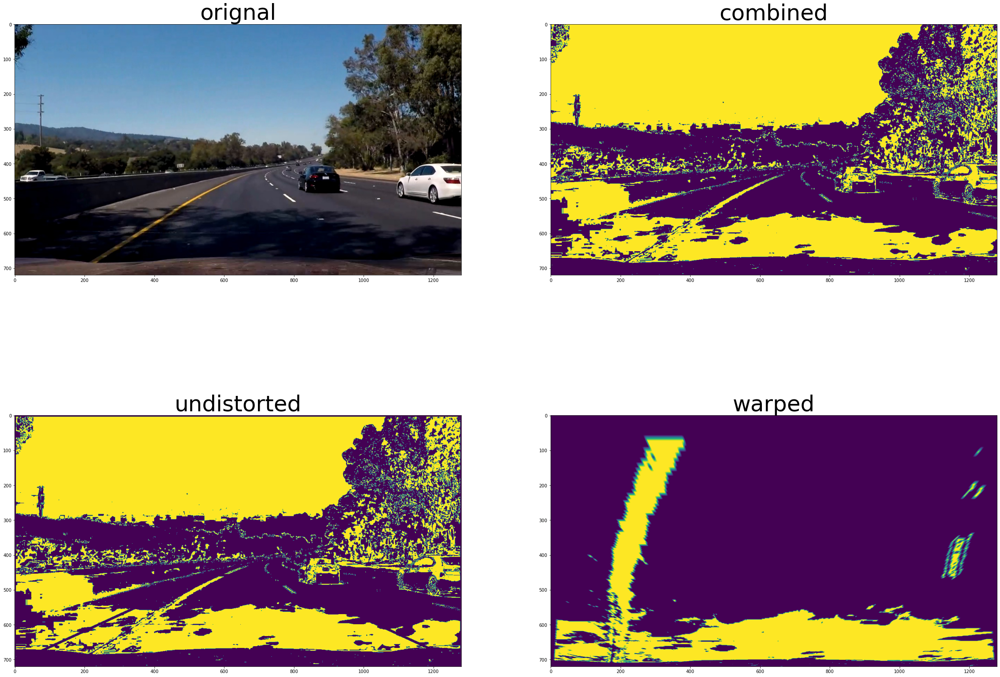

In [25]:
test_images = [mpimg.imread('test_images/' + i) for i in os.listdir('test_images/')]
image = test_images[1]    
masked = get_lane_mask(image)    


combined = get_combined(image, ksize=3)

fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(40,30))
ax1.set_title("orignal", fontsize=50)
ax1.imshow(image)
ax2.set_title("combined", fontsize=50)
ax2.imshow(combined)

w, h = image.shape[1],image.shape[0]
src_pt = ([0, h-10], [548, 458], [732, 458], [w, h-10])
dst_pt = ([0, h], [0, 0], [w, 0], [w, h])
warped, M, Minv = warp_by_perspective(image=combined, src_pt=src_pt, dst_pt=src_pt, showline=True)

ax3.set_title("undistorted", fontsize=50)
ax3.imshow(combined)
ax4.set_title("warped", fontsize=50)
ax4.imshow(warped)

result = np.dstack(( warped, warped, warped)) * 255
cv2.imwrite("output_images/edge_warped_test.jpg", result)

# get lane from histogram and shrink window

In [25]:
#get left/right lane from bottom hist
def find_lane_firsttime(img):
    h,w = img.shape[0],img.shape[1]
    bottom_half = img[img.shape[0]//2:,:]
    histogram = np.sum(bottom_half, axis=0)
    #plt.plot(histogram)
    # get maxmun value of lane
    midpoint = np.int(w//3)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint*2:]) + midpoint*2
    #print(midpoint, leftx_base, rightx_base)
    return leftx_base, rightx_base

def refine_lane_center(binary_warped, sub_win, nonzerox, nonzeroy):
    x1, y1, x2, y2 = sub_win[0],sub_win[1],sub_win[2],sub_win[3]    
    cur_win_img = binary_warped[y1:y2,x1:x2]
    histogram = np.sum(cur_win_img, axis=0)
    center_pos = x1 + np.argmax(histogram)
    
    ret = True
    good_inds = ((nonzeroy >= y1) & (nonzeroy < y2) & (nonzerox >= x1) &  (nonzerox < x2)).nonzero()[0]
    if len(good_inds)<minpix:
        ret = False
    else:    
        # print(good_inds)
        center_pos = np.int(np.mean(nonzerox[good_inds]))
    return ret, center_pos, good_inds
    
def find_lane_pixels(binary_warped, leftx_base, rightx_base):
    if binary_warped.ndim>2:
        binary_img = cv2.cvtColor(binary_warped.astype(np.uint8), cv2.COLOR_RGB2GRAY)
        out_img = binary_warped*255 
    else:
        binary_img = binary_warped
        out_img = cv2.cvtColor((binary_warped*255).astype(np.uint8), cv2.COLOR_GRAY2RGB)
    
    # Step1
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
   
    # Step2
    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_img.shape[0]//nwindows)
    window_width = margin
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step3
    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        ### TO-DO: Find the four below boundaries of the window ###
        win_xleft_low = leftx_current - margin  # Update this
        win_xleft_high = leftx_current + margin  # Update this
        win_xright_low = rightx_current - margin  # Update this
        win_xright_high = rightx_current + margin  # Update this
        
        
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
        
        # Step4
        ### TO-DO: Identify the nonzero pixels in x and y within the window ###
        good_left_inds = leftx_current
        good_right_inds = rightx_current
        good_left_pos = leftx_current
        good_right_pos = rightx_current
        
        sub_win = [win_xleft_low, win_y_low, win_xleft_high, win_y_high]
        ret, good_left_pos, good_left_inds = refine_lane_center(binary_img, sub_win, nonzerox, nonzeroy)
        # print(good_left_pos)
        if ret == True:
            leftx_current = good_left_pos            
            left_lane_inds.append(good_left_inds)
            cv2.line(out_img, (good_left_pos, win_y_low), (good_left_pos, win_y_high), color=(223,20,54), thickness=15)
            # Append these indices to the lists
            left_lane_inds.append(good_left_inds)
            
        sub_win = [win_xright_low, win_y_low, win_xright_high, win_y_high]
        ret, good_right_pos, good_right_inds = refine_lane_center(binary_img, sub_win, nonzerox, nonzeroy)
        if ret == True:
            rightx_current = good_right_pos               
            right_lane_inds.append(good_right_inds)
            cv2.line(out_img, (good_right_pos, win_y_low), (good_right_pos, win_y_high), color=(23,20,254), thickness=15)
            right_lane_inds.append(good_right_inds)
        
        
        # Step5
        ### TO-DO: If you found > minpix pixels, recenter next window ###
        ### (`right` or `leftx_current`) on their mean position ###
        pass # Remove this when you add your function

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    return leftx, lefty, rightx, righty, out_img


def fit_polynomial(binary_warped):
    
    if binary_warped.ndim>2:
        binary_img = cv2.cvtColor(binary_warped.astype(np.uint8), cv2.COLOR_RGB2GRAY)
    else:
        binary_img = binary_warped
    leftx_base, rightx_base = find_lane_firsttime(binary_img)    
    # Find our lane pixels first
    leftx, lefty, rightx, righty, img_labeled = find_lane_pixels(binary_img, leftx_base, rightx_base)

    ### TO-DO: Fit a second order polynomial to each using `np.polyfit` ###
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    # print(lefty, leftx)
    # print(left_fit, right_fit)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty
   
    # Colors in the left and right lane pixel
    img_out = img_labeled
    img_out[lefty, leftx] = [255, 0, 0]
    img_out[righty, rightx] = [0, 0, 255]
    #print(leftx,lefty)

    # Plots the left and right polynomials on the lane lines
    plt.plot(left_fitx, ploty, color='yellow', linewidth=6)
    plt.plot(right_fitx, ploty, color='yellow', linewidth=6)
    #plt.imshow(img_out)

    return img_out, left_fit, right_fit

def label_lane_area(mask, left_poly, right_poly, start_y=0, end_y =720):
    area_mask = mask
    for y in range(start_y, end_y):
        left = evaluate_poly(y, left_poly)
        right = evaluate_poly(y, right_poly)
        area_mask[y][int(left):int(right)] = 1
    return area_mask

def poly_value(indep, poly_coeffs):
    return poly_coeffs[0]*indep**2 + poly_coeffs[1]*indep + poly_coeffs[2]

def center(y, left_poly, right_poly):
    center = (1.5 * poly_value(y, left_poly) - poly_value(y, right_poly)) / 2
    return center

def find_curvature(left_fit, right_fit, width, height):
    y_eval = height//2
    left_rad = np.absolute(((1 + (2 * left_fit[0] * y_eval + left_fit[1])**2) ** 1.5)/(2 * left_fit[0]))
    right_rad = np.absolute(((1 + (2 * right_fit[0] * y_eval + right_fit[1]) ** 2) ** 1.5)/(2 * right_fit[0]))
    #print("Left curve radius: ", left_rad, "pixels")
    #print("Right curve radius: ", right_rad, "pixels")
    curvature = (left_rad + right_rad) / 2
    #print(width/2, left_fit, right_fit)
    centre_pos = center(width/2, left_fit, right_fit)
    return curvature, centre_pos


207 1158


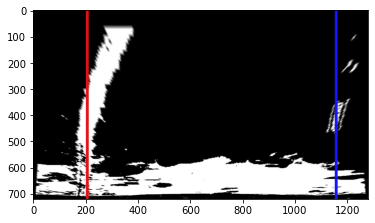

In [56]:
import numpy as np
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import cv2

# Load our image
binary_warped = mpimg.imread('output_images/edge_warped_test.jpg')
gray = cv2.cvtColor(binary_warped, cv2.COLOR_RGB2GRAY)

leftx_base = binary_warped.shape[1]/4
rightx_base = binary_warped.shape[1]*3/4


# find the left/right pos from histogram of the bottom half of the image
leftx_base, rightx_base = find_lane_firsttime(gray)    
print(leftx_base, rightx_base)
h,w = gray.shape[0],gray.shape[1]
cv2.line(binary_warped, (leftx_base, 0), (leftx_base, h), color=(223,20,24), thickness=9)
cv2.line(binary_warped, (rightx_base, 0), (rightx_base, h), color=(23,20,254), thickness=9)
plt.imshow(binary_warped)

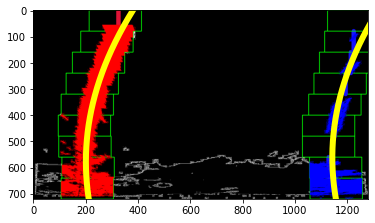

In [57]:
binary_warped = mpimg.imread('output_images/edge_warped_test.jpg')

retule, left_fit, right_fit = fit_polynomial(binary_warped)
cv2.imwrite("output_images/lane_detected_warped2.jpg", result)
plt.imshow(retule)

# test on images independently

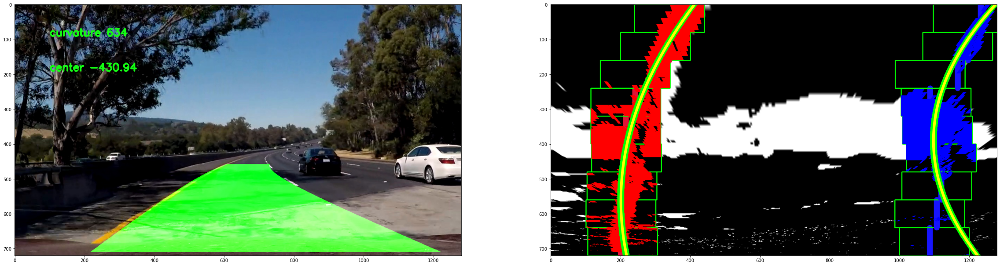

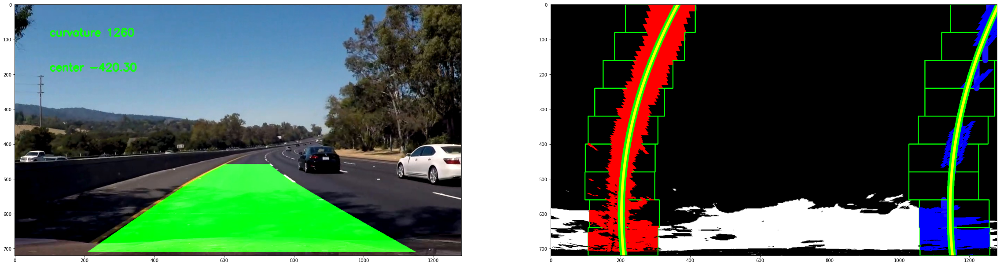

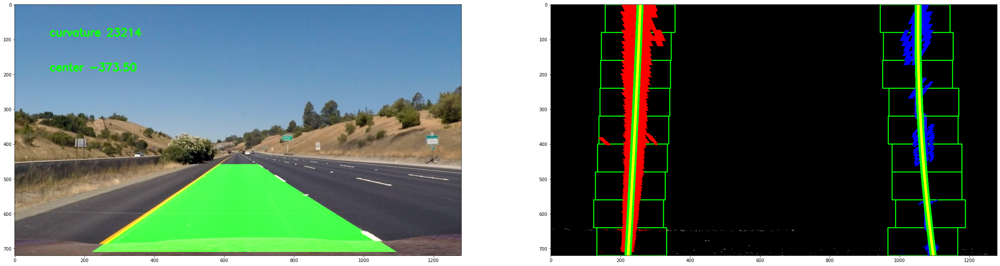

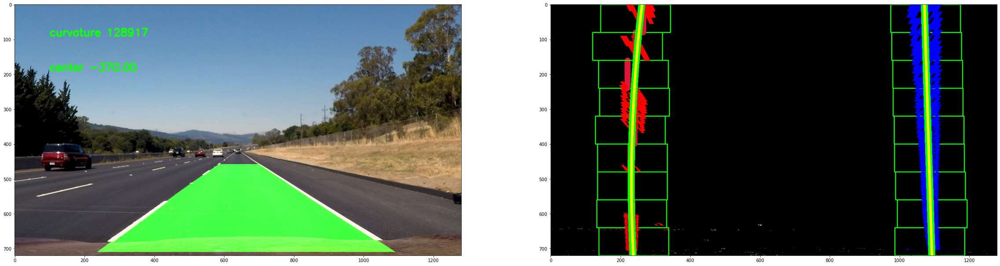

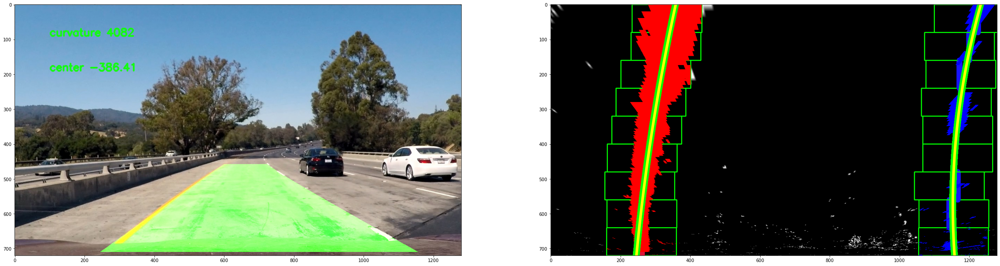

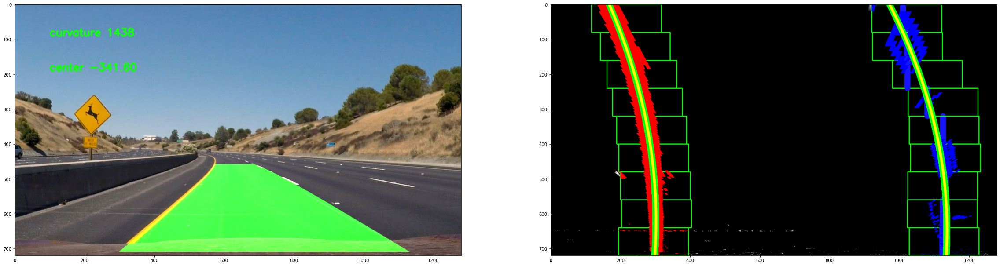

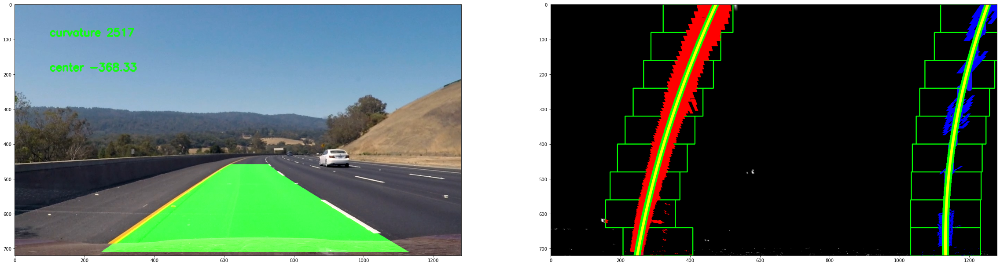

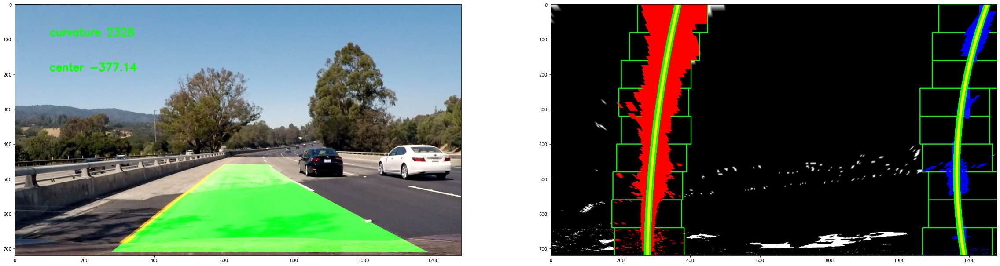

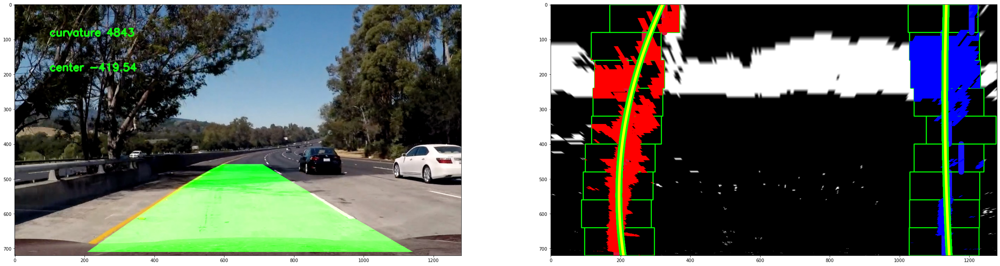

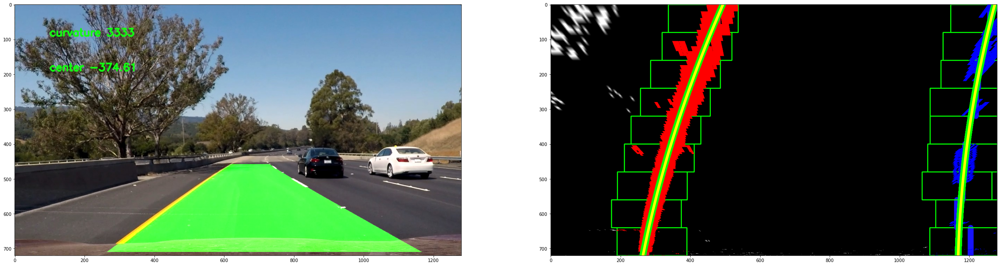

In [65]:
# Read in an image and grayscale it
folder = 'test_images/' 
test_images = [mpimg.imread(folder + i) for i in os.listdir(folder)]
   
#folder = 'project_images/'
frame_count=0
for filename in os.listdir(folder):
    frame_count += 1
    
    image = mpimg.imread(folder + filename)
    
    h,w = image.shape[0], image.shape[1]

    combined = get_combined(image, ksize=3)
    w, h = image.shape[1],image.shape[0]
    src_pt = ([0, h-10], [548, 458], [732, 458], [w, h-10])
    dst_pt = ([0, h], [0, 0], [w, 0], [w, h])
    warped, M, Minv = warp_by_perspective(image=combined, src_pt=src_pt, dst_pt=src_pt, showline=False)

    #fig, (ax1, ax2, ax3, ax4) = plt.subplots(1,4, figsize=(40,30))
    fig, (ax1, ax2) = plt.subplots(1,2, figsize=(40,30))
    ax1.imshow(image)
    ax2.imshow((combined* 255).astype(np.uint8))
    #print(combined.shape)
 
    binary_img = (warped*255).astype(np.uint8)
    leftx_base, rightx_base = find_lane_firsttime(warped)    
    '''
    #binary_warped = (np.dstack(( warped, warped, warped)) * 255).astype(np.uint8)
    binary_warped = (np.dstack(( binary_img//5, binary_img//3, binary_img))).astype(np.uint8)
    #print(binary_warped[0,0])
    cv2.line(binary_warped, (leftx_base, 0), (leftx_base, h), color=(223,220,24), thickness=9)
    cv2.line(binary_warped, (rightx_base, 0), (rightx_base, h), color=(23,220,254), thickness=9)
    #ax3.imshow(binary_warped)
    '''
    binary_warped = (np.dstack(( warped, warped, warped)) * 255).astype(np.uint8)
    #print(binary_warped.ndim)
    result, left_fit, right_fit = fit_polynomial(warped)

    ploty = np.linspace(0, h-1, h).astype(int)
    left_fitx = (left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]).astype(int)
    right_fitx = (right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]).astype(int)
    result[ploty, left_fitx] = [0,255,0]
    #print(left_fitx, ploty)
    for yval in ploty:
        xval = (left_fit[0]*yval**2 + left_fit[1]*yval + left_fit[2]).astype(int)
        result[yval, xval-10:xval+10] = [0,255,0]
        xval = (right_fit[0]*yval**2 + right_fit[1]*yval + right_fit[2]).astype(int)
        result[yval, xval-10:xval+10] = [0,255,0]
    ax2.imshow(result) 
    
    green_channel = np.zeros_like(binary_img)
    for yval in ploty:
        xval_left = (left_fit[0]*yval**2 + left_fit[1]*yval + left_fit[2]).astype(int)
        xval_right = (right_fit[0]*yval**2 + right_fit[1]*yval + right_fit[2]).astype(int)
        result[yval, xval_left:xval_right,1] = 255
        green_channel[yval, xval_left:xval_right] = 255
    
    cur_radius, centre_pos = find_curvature(left_fit, right_fit, w, h)
    
    lane_lines = cv2.warpPerspective(green_channel, Minv, (w, h), flags=cv2.INTER_LINEAR)
    lane_label = lane_lines.nonzero()
    labelx = np.array(lane_label[1])
    labely = np.array(lane_label[0])
    last_img = image.copy()
    last_img[labely,labelx,1] = 255
    
    label = "curvature %d" % cur_radius
    cv2.putText(last_img, label, (100,90), cv2.FONT_HERSHEY_SIMPLEX, 1, (20, 250, 20), 3)
    label = "center %.2f" % centre_pos
    cv2.putText(last_img, label, (100,190), cv2.FONT_HERSHEY_SIMPLEX, 1, (20, 250, 20), 3)
    
    ax1.imshow(last_img)
    #ax4.imshow(lane_lines)    


# test on sequential images

In [26]:
# Read in an image and grayscale it
#test_images = [mpimg.imread('project_images/' + i) for i in os.listdir('project_images/')]

def highlight_lane_line_area(mask_template, left_poly, right_poly, start_y=0, end_y =720):
    area_mask = mask_template
    for y in range(start_y, end_y):
        left = evaluate_poly(y, left_poly)
        right = evaluate_poly(y, right_poly)
        area_mask[y][int(left):int(right)] = 1

    return area_mask

#find_lane_pixels version 2 with previous frame's information
def find_lane_pixels2(binary_warped, leftx_base, rightx_base):
    h, w = binary_warped.shape[0],binary_warped.shape[1]
    if binary_warped.ndim>2:
        binary_img = cv2.cvtColor(binary_warped.astype(np.uint8), cv2.COLOR_RGB2GRAY)
        out_img = binary_warped*255 
    else:
        binary_img = binary_warped
        tempimg = (binary_warped*255).astype(np.uint8)
        out_img = cv2.cvtColor(tempimg, cv2.COLOR_GRAY2RGB)
    
    # Step1
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
   
    # Step2
    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_img.shape[0]//nwindows)
    window_width = margin
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step3
    # Step through the windows one by one
    left_found = 0
    right_found = 0
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        ### TO-DO: Find the four below boundaries of the window ###
        if frame_count<5:
            win_xleft_low = leftx_current - margin 
            win_xleft_high = leftx_current + margin 
            win_xright_low = rightx_current - margin  
            win_xright_high = rightx_current + margin  
        else:    
            win_xleft_low = np.max([leftx_current - margin*2, 0])  
            win_xleft_high = np.min([leftx_current + margin*2, rightx_current - margin*2]) 
            win_xright_low = np.max([rightx_current - margin*2, 0])
            win_xright_high = np.min([rightx_current + margin*2, w-1]) 
        
        #print(leftx_current, rightx_current, margin)

        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
        
        # Step4
        ### TO-DO: Identify the nonzero pixels in x and y within the window ###
        good_left_inds = leftx_current
        good_right_inds = rightx_current
        good_left_pos = leftx_current
        good_right_pos = rightx_current
        
        sub_win = [win_xleft_low, win_y_low, win_xleft_high, win_y_high]
        ret, good_left_pos, good_left_inds = refine_lane_center(binary_img, sub_win, nonzerox, nonzeroy)
        # print(good_left_pos)
        if ret == True:
            leftx_current = good_left_pos            
            left_lane_inds.append(good_left_inds)
            cv2.line(out_img, (good_left_pos, win_y_low), (good_left_pos, win_y_high), color=(223,20,54), thickness=15)
            # Append these indices to the lists
            left_lane_inds.append(good_left_inds)
            left_found += 1
            
        sub_win = [win_xright_low, win_y_low, win_xright_high, win_y_high]
        ret, good_right_pos, good_right_inds = refine_lane_center(binary_img, sub_win, nonzerox, nonzeroy)
        if ret == True:
            rightx_current = good_right_pos               
            right_lane_inds.append(good_right_inds)
            cv2.line(out_img, (good_right_pos, win_y_low), (good_right_pos, win_y_high), color=(23,20,254), thickness=15)
            right_lane_inds.append(good_right_inds)
            right_found += 1        
        
        # Step5
        ### TO-DO: If you found > minpix pixels, recenter next window ###
        ### (`right` or `leftx_current`) on their mean position ###
        pass # Remove this when you add your function

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    return left_found, leftx, lefty, right_found, rightx, righty, out_img


C:\ProgramData\Anaconda3\envs\tf-gpu\lib\site-packages\ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


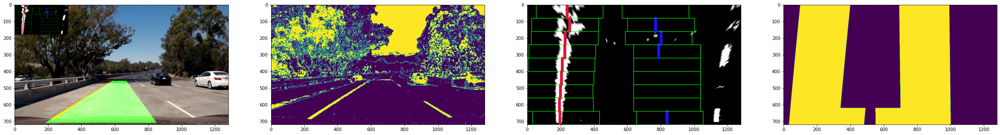

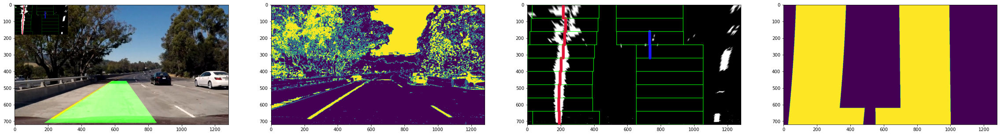

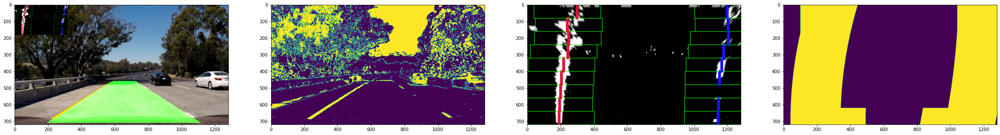

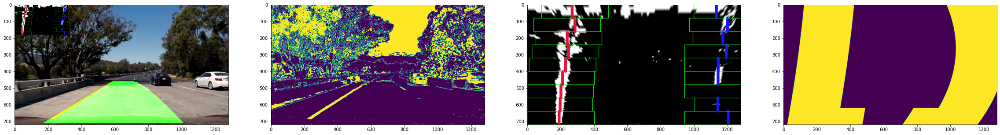

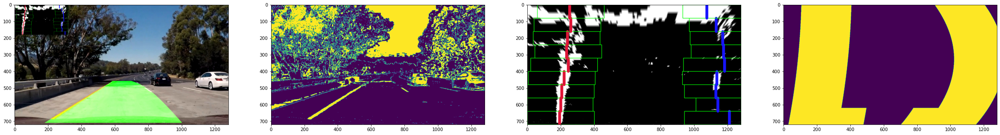

...

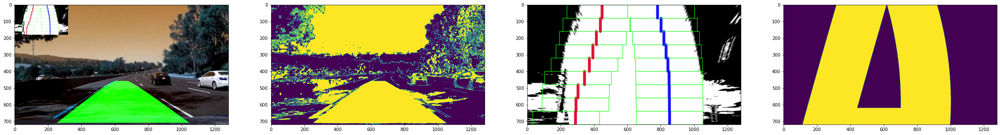

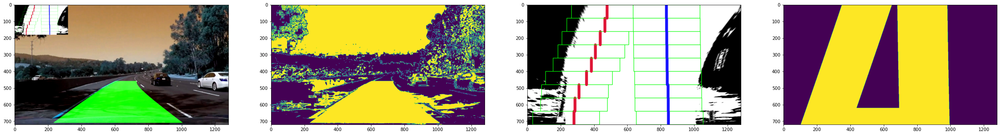

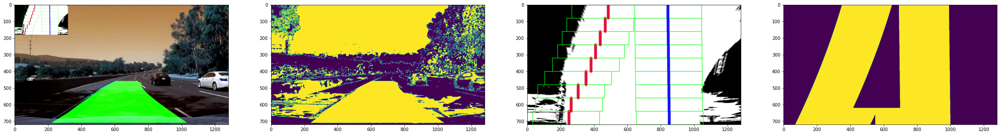

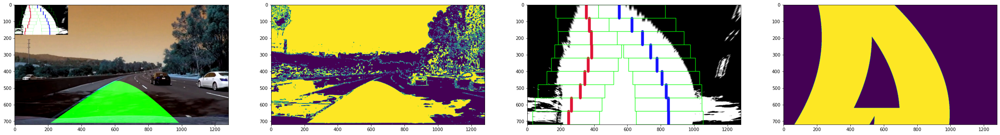

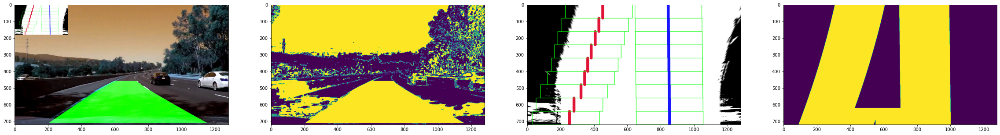

In [30]:
for filename in os.listdir('project_images/'):
    global left_base, right_base, frame_count
    global left_fit_memo, right_fit_memo
    global left_succ_count, right_succ_count
    frame_count += 1
    if frame_count-6<0:
        continue        
    
    image = mpimg.imread('project_images/' + filename)
    h,w = image.shape[0], image.shape[1]
    
    combined = get_combined(image, ksize=3)
    w, h = image.shape[1],image.shape[0]
    src_pt = ([0, h-10], [548, 458], [732, 458], [w, h-10])
    dst_pt = ([0, h], [0, 0], [w, 0], [w, h])
    warped, M, Minv = warp_by_perspective(image=combined, src_pt=src_pt, dst_pt=src_pt, showline=False)

    fig, (ax1, ax2, ax3, ax4) = plt.subplots(1,4, figsize=(40,30))
    ax1.imshow(image)
    ax2.imshow((combined* 255).astype(np.uint8))
    #print(combined.shape)
 
    binary_img = (warped*255).astype(np.uint8)    
    if frame_count-24<5 or left_succ_count<4 or right_succ_count<4:
        left_cur, right_cur = find_lane_firsttime(warped) 
        left_base = left_cur
        right_base = right_cur
        mask_lane = np.zeros_like(warped)
        mask_lane[:,left_cur-margin:left_cur+margin]=255
        mask_lane[:,right_cur-margin:right_cur+margin]=255
        #warped = cv2.bitwise_and(warped, mask_lane)
        #print(left_succ_count, right_succ_count)
        ax3.imshow(mask_lane)
        ax4.imshow(warped)
    else:
        left_cur = left_base
        right_cur = right_base
        #warped = cv2.bitwise_and(warped, mask_lane)
        ax3.imshow(mask_lane)
        ax4.imshow(warped)
        mask_lane[:,:] = 0
        
    result = (np.dstack(( binary_img, binary_img, binary_img)) ).astype(np.uint8)
    left_count, leftx, lefty, right_count, rightx, righty, img_labeled = find_lane_pixels2(warped, left_cur, right_cur)
    if left_count>nwindows//2:
        left_fit = np.polyfit(lefty, leftx, 2)
        left_fit_memo = left_fit
    else:
        left_fit = left_fit_memo
    if right_count>nwindows//2:
        right_fit = np.polyfit(righty, rightx, 2)
        right_fit_memo = right_fit
    else:
        right_fit = right_fit_memo
    small_img = cv2.resize(img_labeled,(w//4,h//4))
    left_succ_count = left_count
    right_succ_count = right_count    
    ax3.imshow(img_labeled) 


    ploty = np.linspace(0, h-1, h).astype(int)
    left_fitx = (left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]).astype(int)
    right_fitx = (right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]).astype(int)
    #result[ploty, left_fitx] = [0,255,0]
    #print(left_fitx, ploty)
    green_channel = np.zeros_like(binary_img)
    newmg = margin*3//2
    for yval in ploty:
        xval_left = (left_fit[0]*yval**2 + left_fit[1]*yval + left_fit[2]).astype(int)
        xval_right = (right_fit[0]*yval**2 + right_fit[1]*yval + right_fit[2]).astype(int)
        result[yval, xval_left-10:xval_left+10] = [0,255,0]
        result[yval, xval_right-10:xval_right+10] = [0,255,0]
        green_channel[yval, xval_left:xval_right] = 255
        if frame_count>4:
            if yval<h-100:
                mask_lane[yval,xval_left-newmg:xval_left+newmg]=255
                mask_lane[yval,xval_right-newmg:xval_right+newmg]=255
            else:    
                mask_lane[yval,xval_left-newmg:xval_left+newmg*2]=255
                mask_lane[yval,xval_right-newmg*2:xval_right+newmg]=255   
        
    lane_lines = cv2.warpPerspective(green_channel, Minv, (w, h), flags=cv2.INTER_LINEAR)
    lane_label = lane_lines.nonzero()
    labelx = np.array(lane_label[1])
    labely = np.array(lane_label[0])
    last_img = image.copy()
    last_img[labely,labelx,1] = 255
    last_img[0:h//4,0:w//4] = small_img
    ax1.imshow(last_img)
    ax4.imshow(mask_lane)
    
    '''
    if frame_count>19:
        image = cv2.cvtColor(lane_lines, cv2.COLOR_RGB2BGR)
        cv2.imwrite("project_images/result_"+filename, last_img)
        cv2.imwrite("project_images/lanefit_"+filename, result)
    '''


In [34]:
def process_pipeline(frame, keep_state=True):
    image = undist(frame, mtx, dist, rvecs, tvecs, False)
    h,w = image.shape[0], image.shape[1]
    global left_base, right_base, processed_frames, mask_lane
    
    combined = get_combined(image, ksize=3)
    warped, M, Minv = warp_by_perspective(image=combined, showline=False)
 
    binary_img = (warped*255).astype(np.uint8)    
    if frame_count<5:
        left_cur, right_cur = find_lane_firsttime(warped)    
        left_base = left_cur
        right_base = right_cur
        mask_lane = np.zeros_like(warped)
        mask_lane[:,left_cur-margin:left_cur+margin]=255
        mask_lane[:,right_cur-margin:right_cur+margin]=255
        warped = cv2.bitwise_and(warped, mask_lane)
    else:
        left_cur = left_base
        right_cur = right_base
        warped = cv2.bitwise_and(warped, mask_lane)
        mask_lane[:,:] = 0

    result = (np.dstack(( warped, warped, warped)) * 255).astype(np.uint8)
    leftx, lefty, rightx, righty, img_labeled = find_lane_pixels(warped, left_cur, right_cur)
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    small_img = cv2.resize(img_labeled,(w//4,h//4))

    ploty = np.linspace(0, h-1, h).astype(int)
    left_fitx = (left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]).astype(int)
    right_fitx = (right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]).astype(int)
    result[ploty, left_fitx] = [0,255,0]
    #print(left_fitx, ploty)
    green_channel = np.zeros_like(binary_img)
    for yval in ploty:
        xval_left = (left_fit[0]*yval**2 + left_fit[1]*yval + left_fit[2]).astype(int)
        xval_right = (right_fit[0]*yval**2 + right_fit[1]*yval + right_fit[2]).astype(int)
        result[yval, xval_left-10:xval_left+10] = [0,255,0]
        result[yval, xval_right-10:xval_right+10] = [0,255,0]
        green_channel[yval, xval_left:xval_right] = 255
        if frame_count>4:
            if yval<h-100:
                mask_lane[yval,xval_left-margin:xval_left+margin]=255
                mask_lane[yval,xval_right-margin:xval_right+margin]=255
            else:    
                mask_lane[yval,xval_left-margin:xval_left+margin*2]=255
                mask_lane[yval,xval_right-margin*2:xval_right+margin]=255
        
    lane_lines = cv2.warpPerspective(green_channel, Minv, (w, h), flags=cv2.INTER_LINEAR)
    lane_label = lane_lines.nonzero()
    labelx = np.array(lane_label[1])
    labely = np.array(lane_label[0])
    last_img = image.copy()
    last_img[labely,labelx,1] = last_img[labely,labelx,1]+50    
    last_img[0:h//4,0:w//4] = small_img
    
    processed_frames += 1
    label = "%d" % processed_frames
    cv2.putText(last_img, label, (10,90), cv2.FONT_HERSHEY_SIMPLEX, 1, (209, 80, 0, 255), 3)
    
    return last_img


def wirteImage(frame, keep_state=True):
    global processed_frames
    processed_frames += 1
    if processed_frames<20:
        label = "%d.jpg" % processed_frames
        image = cv2.cvtColor(frame, cv2.COLOR_RGB2BGR)
        cv2.imwrite("project_images/img_"+label, image)
    return frame


In [137]:
import pickle
from moviepy.editor import VideoFileClip
dist_pickle = pickle.load( open( "camera_calib_matrix.dat", "rb" ) )
mtx = dist_pickle["mtx"]
dist = dist_pickle["dist"]
rvecs = dist_pickle["rvecs"]
tvecs = dist_pickle["tvecs"]
frame_count=0

clip = VideoFileClip('project_video.mp4').fl_image(process_pipeline)
clip.write_videofile('project_video_out.mp4', audio=False)


t:   0%|          | 0/1260 [00:00<?, ?it/s, now=None]


Moviepy - Building video project_video_out.mp4.
Moviepy - Writing video project_video_out.mp4



t:  20%|█▉        | 246/1260 [00:44<03:08,  5.39it/s, now=None]


t:  39%|███▉      | 490/1260 [01:30<02:22,  5.42it/s, now=None]


t:  58%|█████▊    | 734/1260 [02:15<01:33,  5.65it/s, now=None]


t:  78%|███████▊  | 978/1260 [03:00<00:51,  5.43it/s, now=None]


t:  97%|█████████▋| 1218/1260 [03:44<00:07,  5.63it/s, now=None]


t:  10%|▉         | 121/1260 [05:16<04:00,  4.73it/s, now=None] 

Moviepy - Done !
Moviepy - video ready project_video_out.mp4


# on challenge videos

In [181]:
import pickle
from moviepy.editor import VideoFileClip
dist_pickle = pickle.load( open( "camera_calib_matrix.dat", "rb" ) )
mtx = dist_pickle["mtx"]
dist = dist_pickle["dist"]
rvecs = dist_pickle["rvecs"]
tvecs = dist_pickle["tvecs"]

# get image for static processing
def wirteImage(frame, keep_state=True):
    global processed_frames
    processed_frames += 1
    if processed_frames<2:
        label = "%d.jpg" % (processed_frames//15)
        image = cv2.cvtColor(frame, cv2.COLOR_RGB2BGR)
        cv2.imwrite("challenge_images/img_"+label, image)
    return frame

processed_frames=0
clip = VideoFileClip('challenge_video.mp4').fl_image(wirteImage) 
clip.write_videofile('challenge_video_out.mp4', audio=False)

t:   1%|          | 4/485 [00:00<00:12, 40.00it/s, now=None]

Moviepy - Building video challenge_video_out.mp4.
Moviepy - Writing video challenge_video_out.mp4



Moviepy - Done !
Moviepy - video ready challenge_video_out.mp4


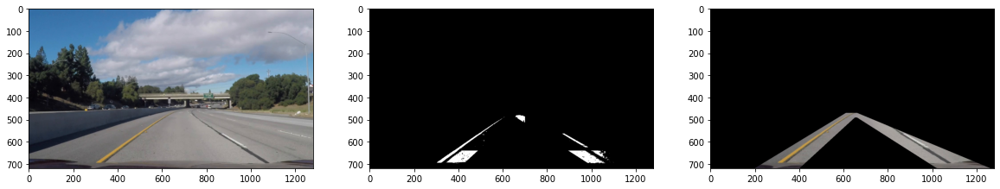

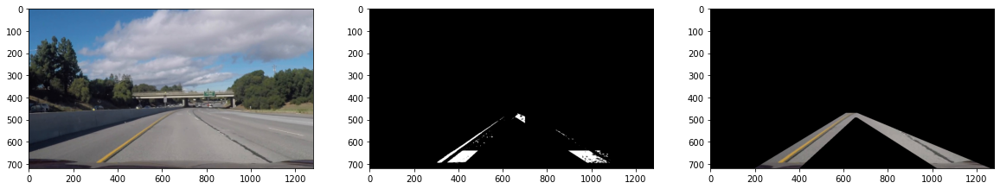

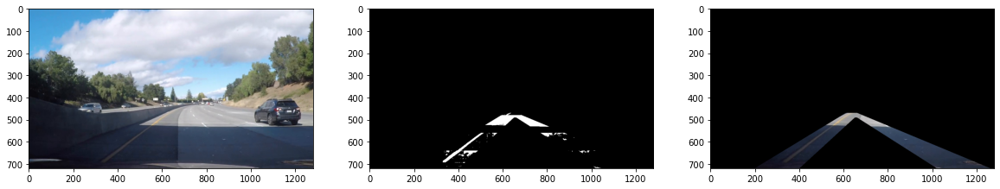

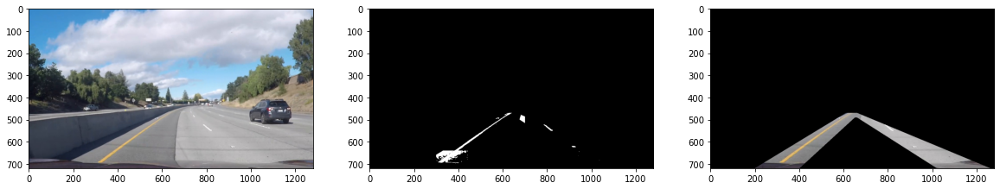

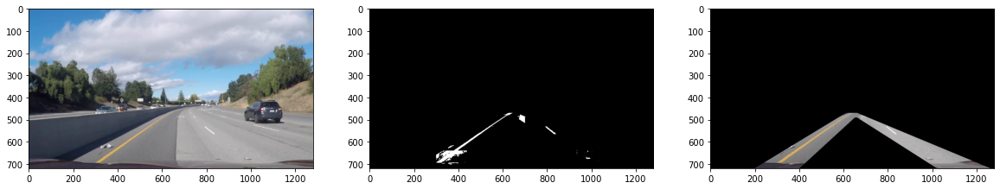

...

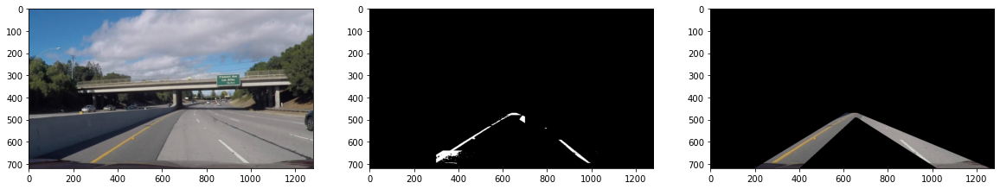

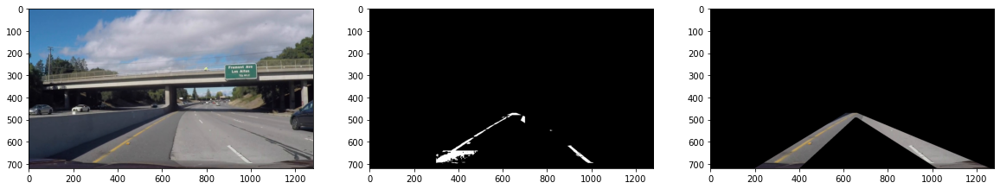

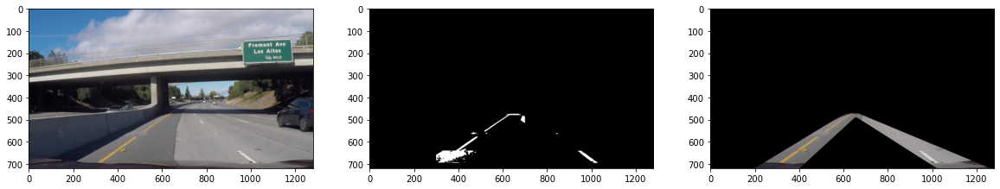

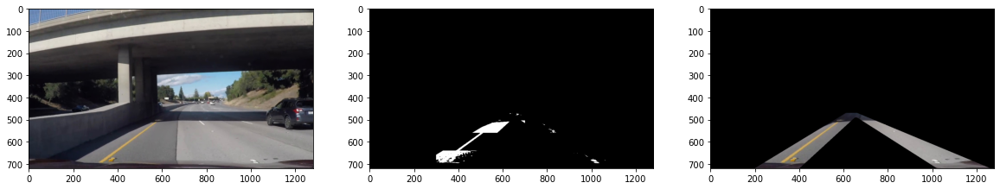

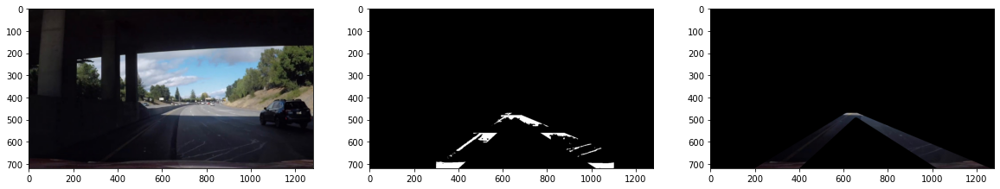

In [64]:
import pickle
from moviepy.editor import VideoFileClip
dist_pickle = pickle.load( open( "camera_calib_matrix.dat", "rb" ) )
mtx = dist_pickle["mtx"]
dist = dist_pickle["dist"]
rvecs = dist_pickle["rvecs"]
tvecs = dist_pickle["tvecs"]

def get_thres(gray, mask):
    h,w = image.shape[0], image.shape[1]
    binary_img = np.zeros_like(gray)
    margin = 200
    leftx_base = 500
    rightx_base = 900
    window_height = np.int(h//nwindows)
    window_width = margin
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        y1 = h - (window+1)*window_height
        y2 = h - window*window_height
        xl1 = leftx_base - margin  # Update this
        xl2 = leftx_base + margin  # Update this
        xr1 = rightx_base - margin  # Update this
        xr2 = rightx_base + margin  # Update this
        
        sub_img = gray[y1:y2, xl1:xl2]
        sub_mask = mask[y1:y2, xl1:xl2]
        avg = np.round(cv2.mean(sub_img,mask=sub_mask)[0]*1.1)
        ret, binary_img[y1:y2, xl1:xl2] = cv2.threshold(sub_img,avg,255,cv2.THRESH_BINARY)

        sub_img = gray[y1:y2, xr1:xr2]
        sub_mask = mask[y1:y2, xr1:xr2]
        avg = np.round(cv2.mean(sub_img,mask=sub_mask)[0]*1.1)
        ret, binary_img[y1:y2, xr1:xr2] = cv2.threshold(sub_img,avg,255,cv2.THRESH_BINARY)
    return binary_img 

def get_thres2(gray):
    h,w = image.shape[0], image.shape[1]
    binary_img = np.zeros_like(gray)
    margin = 300
    leftx_base = 600
    rightx_base = 900
    window_height = np.int(h//nwindows*2)
    window_width = margin
    for window in range(nwindows*2):
        # Identify window boundaries in x and y (and right and left)
        y1 = binary_warped.shape[0] - (window+1)*window_height
        y2 = binary_warped.shape[0] - window*window_height
        xl1 = leftx_base - margin  # Update this
        xl2 = leftx_base + margin  # Update this
        xr1 = rightx_base - margin  # Update this
        xr2 = rightx_base + margin  # Update this
        
        sub_win = [xl1, y1, xl2, y2]
        sub_img = gray[y1:y2, xl1:xl2]
        avg = np.average(sub_img).astype(np.uint8) + 30
        
        #binary_img[(sub_img>thresh[0]) & (scaled_sobel<=thresh[1])] = 1
        
        ret, binary_img[y1:y2, xl1:xl2] = cv2.threshold(sub_img,avg,255,cv2.THRESH_BINARY)
        sub_img = gray[y1:y2, xr1:xr2]
        avg = np.average(sub_img).astype(np.uint8) + 30
        ret, binary_img[y1:y2, xr1:xr2] = cv2.threshold(sub_img,avg,255,cv2.THRESH_BINARY)
    return binary_img 

def show_split(image):
    out_img = image
    h,w = image.shape[0], image.shape[1]
    masked_img = get_lane_mask(image)
    hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    hue, lit, sat = cv2.split(hls)

    gray = cv2.cvtColor(masked_img, cv2.COLOR_RGB2GRAY)
    blurred = cv2.GaussianBlur(gray, (7, 7), 0)
    mask = np.zeros_like(gray)
    mask[gray>1] = 255
    
    binary_img = get_thres(gray, mask)

    #print(h,w)
    blue, green, red = cv2.split(image)
    src_pos = ([100, h-10], [620, 458], [732, 458], [w-50, h-10]) 
    dst_pos = ([0, h], [0, 0], [w, 0], [w, h])    
    warped, M, Minv = warp_by_perspective(image=image, src_pt=src_pos, dst_pt=dst_pos, showline=False)
    out_img = warped
    fig, (sub1, sub2, sub3) = plt.subplots(1,3)
    fig.set_figheight(15)
    fig.set_figwidth(20)
    sub1.imshow(image)
    
        
        
    threshed = cv2.adaptiveThreshold(gray,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C,cv2.THRESH_BINARY_INV,61,2)
    #binary_img[0:h, 400:780] = 0
    out_img = cv2.cvtColor(binary_img, cv2.COLOR_GRAY2RGB)
        
    
    gradx = abs_sobel_thresh(sat, orient='x', sobel_kernel=3, thresh=(20, 100))  # sobel on x
    grady = abs_sobel_thresh(sat, orient='y', sobel_kernel=3, thresh=(20, 100))  # sobel on y
    grad_sobel = ((gradx==1) & (grady==1)).astype(np.uint8)*255  # sobel together
    thres = np.zeros_like(grad_sobel) 
    thres[grad_sobel>150] = 255

    sub2.imshow(out_img)
    sub3.imshow(masked_img)
    
processed_frames = 0    
for filename in os.listdir('challenge_images/'):
    processed_frames += 1
    if processed_frames>24:
        continue     
    
    image = mpimg.imread('challenge_images/' + filename)
    h,w = image.shape[0], image.shape[1]
    
    show_split(image)

In [157]:
# test edge
def pipeline_edge(frame, keep_state=True):
    ksize=3
    hls = cv2.cvtColor(frame, cv2.COLOR_RGB2HLS)
    h, l, s = cv2.split(hls)
    gradx = abs_sobel_thresh(frame, orient='x', sobel_kernel=ksize, thresh=(20, 100))  # sobel on x
    grady = abs_sobel_thresh(frame, orient='y', sobel_kernel=ksize, thresh=(20, 100))  # sobel on y
    grad_sobel = (gradx==1) & (grady==1)  # sobel together
    combined = get_combined(frame, 3)

    out_color = cv2.cvtColor(grad_sobel.astype(np.uint8)*255, cv2.COLOR_GRAY2RGB)
    return out_color

clip = VideoFileClip('challenge_video.mp4').fl_image(pipeline_edge) 
clip.write_videofile('challenge_video_out.mp4', audio=False)

In [115]:
def process_pipeline2(frame, keep_state=True):
    global left_base, right_base, frame_count
    global left_fit_memo, right_fit_memo, mask_lane
    global left_succ_count, right_succ_count
    frame_count += 1
    
    image = frame #undist(frame, mtx, dist, rvecs, tvecs, False)
    h,w = image.shape[0], image.shape[1]
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)    
    blurred = cv2.GaussianBlur(gray, (7, 7), 0)
    
    src_pos = ([100, h-10], [620, 458], [732, 458], [w-50, h-10]) 
    dst_pos = ([0, h], [0, 0], [w, 0], [w, h])    
    warped, M, Minv = warp_by_perspective(image=blurred, src_pt=src_pos, dst_pt=dst_pos, showline=False)
    binary_img = get_thres(warped)
    #plt.imshow(binary_img)

    #print(combined.shape)
 
    left_cur, right_cur = find_lane_firsttime(warped) 
    left_base = left_cur
    right_base = right_cur
    #print(frame_count, left_cur, right_cur)
        
    result = (np.dstack(( binary_img, binary_img, binary_img)) ).astype(np.uint8)
    left_count, leftx, lefty, right_count, rightx, righty, img_labeled = find_lane_pixels2(warped, left_cur, right_cur)
    if left_count>nwindows//2:
        left_fit = np.polyfit(lefty, leftx, 2)
        left_fit_memo = left_fit
    else:
        left_fit = left_fit_memo
    if right_count>nwindows//2:
        right_fit = np.polyfit(righty, rightx, 2)
        right_fit_memo = right_fit
    else:
        right_fit = right_fit_memo
    #print(left_fit, right_fit)
    left_succ_count = left_count
    right_succ_count = right_count    


    ploty = np.linspace(0, h-1, h).astype(int)
    left_fitx = (left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]).astype(int)
    right_fitx = (right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]).astype(int)
    #result[ploty, left_fitx] = [0,255,0]
    #print(left_fitx, ploty)
    green_channel = np.zeros_like(binary_img)
    for yval in ploty:
        xval_left = (left_fit[0]*yval**2 + left_fit[1]*yval + left_fit[2]).astype(int)
        xval_right = (right_fit[0]*yval**2 + right_fit[1]*yval + right_fit[2]).astype(int)        
        result[yval, xval_left-10:xval_left+10] = [0,255,0]
        result[yval, xval_right-10:xval_right+10] = [0,255,0]
        green_channel[yval, xval_left:xval_right] = 255

    small_img = cv2.resize(binary_img,(w//4,h//4)) #img_labeled
    lane_lines = cv2.warpPerspective(green_channel, Minv, (w, h), flags=cv2.INTER_LINEAR)
    lane_label = lane_lines.nonzero()
    labelx = np.array(lane_label[1])
    labely = np.array(lane_label[0])
    last_img = image.copy()
    last_img[labely,labelx,1] = 255
    last_img[0:h//4,0:w//4] = np.dstack((small_img, small_img, small_img))
    return last_img
    

In [116]:
import pickle
from moviepy.editor import VideoFileClip
dist_pickle = pickle.load( open( "camera_calib_matrix.dat", "rb" ) )
mtx = dist_pickle["mtx"]
dist = dist_pickle["dist"]
rvecs = dist_pickle["rvecs"]
tvecs = dist_pickle["tvecs"]
frame_count=0

'''
for filename in os.listdir('challenge_images/'):
    processed_frames += 1
    if processed_frames>32:
        continue     
    
    image = mpimg.imread('challenge_images/' + filename)
    process_pipeline2(image)
'''
margin = 100
left_cur = 300
right_cur = 800
clip = VideoFileClip('challenge_video.mp4').fl_image(process_pipeline2)
clip.write_videofile('challenge_video_out.mp4', audio=False)


t:   0%|          | 0/485 [00:00<?, ?it/s, now=None]

1 223 1005
223 1005 100
222 1004 100
221 1003 100
220 1002 100
219 1001 100
218 1000 100
217 999 100
216 998 100
215 997 100
Moviepy - Building video challenge_video_out.mp4.
Moviepy - Writing video challenge_video_out.mp4

2 223 1005
223 1005 100
222 1004 100
221 1003 100
220 1002 100
219 1001 100
218 1000 100
217 999 100
216 998 100
215 997 100



t:   1%|          | 3/485 [00:01<03:37,  2.21it/s, now=None]

3 222 1001
222 1001 100
221 1000 100
220 999 100
219 998 100
218 997 100
217 996 100
216 995 100
215 994 100
214 993 100
4 222 1005
222 1005 100
221 1004 100



t:   1%|          | 4/485 [00:01<02:54,  2.75it/s, now=None]

220 1003 100
219 1002 100
218 1001 100
217 1000 100
216 999 100
215 998 100
214 997 100
5 221 1006
221 1006 100
220 1005 100
219 1004 100
218 1003 100
217


t:   1%|          | 5/485 [00:01<02:33,  3.13it/s, now=None]

 1002 100
216 1001 100
215 1000 100
214 999 100
213 998 100
6 223 1004
223 1004 100
222 1003 100
221


t:   1%|          | 6/485 [00:01<02:16,  3.52it/s, now=None]

 1002 100
220 1001 100
219 1000 100
218 999 100
217 998 100
216 997 100
215 996 100
7 224 1005
224 1005 100
223 1004 100
222 1003 100
221 1002 100
220 1001 100
219 1000 100
218 999 100
217 998 100
216 997 100



t:   1%|▏         | 7/485 [00:02<02:04,  3.83it/s, now=None]

8 225 1004
225 1004 100
224 1003 100
223 1002 100
222 1001 100
221 1000 100
220 999 100
219 998 100
218 997 100
217 996 100



t:   2%|▏         | 8/485 [00:02<01:59,  4.00it/s, now=None]

9 225 1007
225 1007 100
224 1006 100
223 1005 100
222 1004 100
221 1003 100
220 1002 100
219 1001 100
218 1000 100
217 999 100



t:   2%|▏         | 9/485 [00:02<01:54,  4.14it/s, now=None]

10 228 1008
228 1008 100
227 1007 100
226 1006 100
225 1005 100
224 1004 100
223 1003 100
222 1002 100
221 1001 100
220 1000 100



t:   2%|▏         | 10/485 [00:02<01:49,  4.35it/s, now=None]

11 228 1011
228 1011 100
227 1010 100
226 1009 100
225 1008 100
224 1007 100
223 1006 100
222 1005 100
221 1004 100
220 1003 100



t:   2%|▏         | 11/485 [00:02<01:45,  4.51it/s, now=None]


12 226 1016
226 1016 100
225 1015 100
224 1014 100
223 1013 100
222 1012 100
221 1011 100
220 1010 100
219 1009 100
218 1008 100


t:   2%|▏         | 12/485 [00:03<01:41,  4.65it/s, now=None]

13 225 1022
225 1022 100
224 1021 100
223 1020 100
222 1019 100
221 1018 100
220 1017 100
219 1016 100
218 1015 100
217 1014 100



t:   3%|▎         | 13/485 [00:03<01:40,  4.68it/s, now=None]

14 224 1028
224 1028 100
223 1027 100
222 1026 100
221 1025 100
220 1024 100
219 1023 100
218 1022 100
217 1021 100
216 1020 100



t:   3%|▎         | 14/485 [00:03<01:40,  4.69it/s, now=None]


15 223 1033
223 1033 100
222 1032 100
221 1031 100
220 1030 100
219 1029 100
218 1028 100
217 1027 100
216 1026 100
215 1025 100


t:   3%|▎         | 15/485 [00:03<01:38,  4.75it/s, now=None]


16 221 1035
221 1035 100
220 1034 100
219 1033 100
218 1032 100
217 1031 100
216 1030 100
215 1029 100
214 1028 100
213 1027 100


t:   3%|▎         | 16/485 [00:03<01:37,  4.79it/s, now=None]

17 220 1035
220 1035 100
219 1034 100
218 1033 100
217 1032 100
216 1031 100
215 1030 100
214 1029 100
213 1028 100
212 1027 100



t:   4%|▎         | 17/485 [00:04<01:38,  4.77it/s, now=None]

18 219 1038
219 1038 100
218 1037 100
217 1036 100
216 1035 100
215 1034 100
214 1033 100
213 1032 100
212 1031 100
211 1030 100



t:   4%|▎         | 18/485 [00:04<01:37,  4.78it/s, now=None]

19 220 1036
220 1036 100
219 1035 100
218 1034 100
217 1033 100
216 1032 100
215 1031 100
214 1030 100
213 1029 100
212 1028 100



t:   4%|▍         | 19/485 [00:04<01:38,  4.73it/s, now=None]

20 217 1038
217 1038 100
216 1037 100
215 1036 100
214 1035 100
213 1034 100
212 1033 100
211 1032 100
210 1031 100
209 1030 100



t:   4%|▍         | 20/485 [00:04<01:38,  4.74it/s, now=None]

21 216 1039
216 1039 100
215 1038 100
214 1037 100
213 1036 100
212 1035 100
211 1034 100
210 1033 100
209 1032 100
208 1031 100



t:   4%|▍         | 21/485 [00:05<01:38,  4.73it/s, now=None]

22 214 983
214 983 100
213 982 100
212 981 100
211 980 100
210 979 100
209 978 100
208 977 100
207 976 100
206 975 100



t:   5%|▍         | 22/485 [00:05<01:37,  4.73it/s, now=None]

23 215 981
215 981 100
214 980 100
213 979 100
212 978 100
211 977 100
210 976 100
209 975 100
208 974 100
207 973 100



t:   5%|▍         | 23/485 [00:05<01:36,  4.77it/s, now=None]

24 211 986
211 986 100
210 985 100
209 984 100
208 983 100
207 982 100
206 981 100
205 980 100
204 979 100
203 978 100



t:   5%|▍         | 24/485 [00:05<01:39,  4.62it/s, now=None]

25 213 982
213 982 100
212 981 100
211 980 100
210 979 100
209 978 100
208 977 100
207 976 100
206 975 100
205 974 100



t:   5%|▌         | 25/485 [00:05<01:38,  4.67it/s, now=None]

26 214 983
214 983 100
213 982 100
212 981 100
211 980 100
210 979 100
209 978 100
208 977 100
207 976 100
206 975 100



t:   5%|▌         | 26/485 [00:06<01:38,  4.67it/s, now=None]

27 217 978
217 978 100
216 977 100
215 976 100
214 975 100
213 974 100
212 973 100
211 972 100
210 971 100
209 970 100



t:   6%|▌         | 27/485 [00:06<01:38,  4.66it/s, now=None]

28 215 980
215 980 100
214 979 100
213 978 100
212 977 100
211 976 100
210 975 100
209 974 100
208 973 100
207 972 100



t:   6%|▌         | 28/485 [00:06<01:38,  4.66it/s, now=None]


29 217 979
217 979 100
216 978 100
215 977 100
214 976 100
213 975 100
212 974 100
211 973 100
210 972 100
209 971 100


t:   6%|▌         | 29/485 [00:06<01:36,  4.72it/s, now=None]

30 217 981
217 981 100
216 980 100
215 979 100
214 978 100
213 977 100
212 976 100
211 975 100
210 974 100
209 973 100



t:   6%|▌         | 30/485 [00:06<01:35,  4.77it/s, now=None]

31 215 984
215 984 100
214 983 100
213 982 100
212 981 100
211 980 100
210 979 100
209 978 100
208 977 100
207 976 100



t:   6%|▋         | 31/485 [00:07<01:34,  4.79it/s, now=None]

32 215 988
215 988 100
214 987 100
213 986 100
212 985 100
211 984 100
210 983 100
209 982 100
208 981 100
207 980 100



t:   7%|▋         | 32/485 [00:07<01:34,  4.80it/s, now=None]

33 214 992
214 992 100
213 991 100
212 990 100
211 989 100
210 988 100
209 987 100
208 986 100
207 985 100
206 984 100



t:   7%|▋         | 33/485 [00:07<01:34,  4.76it/s, now=None]

34 213 995
213 995 100
212 994 100
211 993 100
210 992 100
209 991 100
208 990 100
207 989 100
206 988 100
205 987 100



t:   7%|▋         | 34/485 [00:07<01:34,  4.76it/s, now=None]

35 212 998
212 998 100
211 997 100
210 996 100
209 995 100
208 994 100
207 993 100
206 992 100
205 991 100
204 990 100



t:   7%|▋         | 35/485 [00:08<01:35,  4.72it/s, now=None]

36 210 1004
210 1004 100
209 1003 100
208 1002 100
207 1001 100
206 1000 100
205 999 100
204 998 100
203 997 100
202 996 100



t:   7%|▋         | 36/485 [00:08<01:35,  4.68it/s, now=None]

37 212 1003
212 1003 100
211 1002 100
210 1001 100
209 1000 100
208 999 100
207 998 100
206 997 100
205 996 100
204 995 100



t:   8%|▊         | 37/485 [00:08<01:35,  4.68it/s, now=None]

38 213 1004
213 1004 100
212 1003 100
211 1002 100
210 1001 100
209 1000 100
208 999 100
207 998 100
206 997 100
205 996 100



t:   8%|▊         | 38/485 [00:08<01:37,  4.60it/s, now=None]


39 213 1006
213 1006 100
212 1005 100
211 1004 100
210 1003 100
209 1002 100
208 1001 100
207 1000 100
206 999 100
205 998 100


t:   8%|▊         | 39/485 [00:08<01:35,  4.67it/s, now=None]

40 211 1012
211 1012 100
210 1011 100
209 1010 100
208 1009 100
207 1008 100
206 1007 100
205 1006 100
204 1005 100
203 1004 100



t:   8%|▊         | 40/485 [00:09<01:35,  4.68it/s, now=None]

41 209 1018
209 1018 100
208 1017 100
207 1016 100
206 1015 100
205 1014 100
204 1013 100
203 1012 100
202 1011 100
201 1010 100



t:   8%|▊         | 41/485 [00:09<01:35,  4.66it/s, now=None]

42 202 1027
202 1027 100
201 1026 100
200 1025 100
199 1024 100
199 1023 100
199 1022 100
199 1021 100
199 1020 100
199 1019 100



t:   9%|▊         | 42/485 [00:09<01:35,  4.66it/s, now=None]

43 200 1031
200 1031 100
199 1030 100
199 1029 100
199 1028 100
199 1027 100
199 1026 100
199 1025 100
199 1024 100
199 1023 100



t:   9%|▉         | 43/485 [00:09<01:35,  4.65it/s, now=None]

44 200 949
200 949 100
199 948 100
199 947 100
199 946 100
199 945 100
199 944 100
199 943 100
199 942 100
199 941 100



t:   9%|▉         | 44/485 [00:09<01:36,  4.57it/s, now=None]

45 198 950
198 950 100
198 949 100
198 948 100
198 947 100
198 946 100
198 945 100
198 944 100
198 943 100
198 942 100



t:   9%|▉         | 45/485 [00:10<01:36,  4.55it/s, now=None]

46 200 946
200 946 100
199 945 100
199 944 100
199 943 100
199 942 100
199 941 100
199 940 100
199 939 100
199 938 100



t:   9%|▉         | 46/485 [00:10<01:37,  4.50it/s, now=None]

47 194 953
194 953 100
196 952 100
197 951 100
198 950 100
198 949 100
198 948 100
198 947 100
198 946 100
198 945 100



t:  10%|▉         | 47/485 [00:10<01:38,  4.46it/s, now=None]

48 191 957
191 957 100
195 956 100
197 955 100
198 954 100
198 953 100
198 952 100
198 951 100
198 950 100
198 949 100



t:  10%|▉         | 48/485 [00:10<01:35,  4.55it/s, now=None]

49 189 961
189 961 100
194 960 100
196 959 100
197 958 100
198 957 100
198 956 100
198 955 100
198 954 100
198 953 100



t:  10%|█         | 49/485 [00:11<01:35,  4.55it/s, now=None]

50 190 960
190 960 100
194 959 100
196 958 100
197 957 100
198 956 100
198 955 100
198 954 100
198 953 100
198 952 100



t:  10%|█         | 50/485 [00:11<01:37,  4.47it/s, now=None]

51 189 961
189 961 100
194 960 100
196 959 100
197 958 100
198 957 100
198 956 100
198 955 100
198 954 100
198 953 100



t:  11%|█         | 51/485 [00:11<01:36,  4.50it/s, now=None]

52 188 962
188 962 100
193 961 100
196 960 100
197 959 100
198 958 100
198 957 100
198 956 100
198 955 100
198 954 100



t:  11%|█         | 52/485 [00:11<01:36,  4.47it/s, now=None]

53 187 964
187 964 100
193 963 100
196 962 100
197 961 100
198 960 100
198 959 100
198 958 100
198 957 100
198 956 100



t:  11%|█         | 53/485 [00:11<01:38,  4.40it/s, now=None]

54 188 968
188 968 100
193 967 100
196 966 100
197 965 100
198 964 100
198 963 100
198 962 100
198 961 100
198 960 100



t:  11%|█         | 54/485 [00:12<01:35,  4.50it/s, now=None]

55 182 976
182 976 100
190 975 100
194 974 100
196 973 100
197 972 100
198 971 100
198 970 100
198 969 100
198 968 100



t:  11%|█▏        | 55/485 [00:12<01:33,  4.60it/s, now=None]

56 182 979
182 979 100
190 978 100
194 977 100
196 976 100
197 975 100
198 974 100
198 973 100
198 972 100
198 971 100



t:  12%|█▏        | 56/485 [00:12<01:33,  4.59it/s, now=None]

57 182 985
182 985 100
190 984 100
194 983 100
196 982 100
197 981 100
198 980 100
198 979 100
198 978 100
198 977 100



t:  12%|█▏        | 57/485 [00:12<01:32,  4.64it/s, now=None]

58 182 990
182 990 100
190 989 100
194 988 100
196 987 100
197 986 100
198 985 100
198 984 100
198 983 100
198 982 100



t:  12%|█▏        | 58/485 [00:13<01:32,  4.64it/s, now=None]

59 183 996
183 996 100
191 995 100
195 994 100
197 993 100
198 992 100
198 991 100
198 990 100
198 989 100
198 988 100



t:  12%|█▏        | 59/485 [00:13<01:31,  4.65it/s, now=None]


60 186 1000
186 1000 100
192 999 100
195 998 100
197 997 100
198 996 100
198 995 100
198 994 100
198 993 100
198 992 100


t:  12%|█▏        | 60/485 [00:13<01:30,  4.69it/s, now=None]

61 183 1006
183 1006 100
191 1005 100
195 1004 100
197 1003 100
198 1002 100
198 1001 100
198 1000 100
198 999 100
198 998 100



t:  13%|█▎        | 61/485 [00:13<01:31,  4.66it/s, now=None]

62 181 1008
181 1008 100
190 1007 100
194 1006 100
196 1005 100
197 1004 100
198 1003 100
198 1002 100
198 1001 100
198 1000 100



t:  13%|█▎        | 62/485 [00:13<01:29,  4.73it/s, now=None]

63 178 981
178 981 100
188 980 100
193 979 100
196 978 100
197 977 100
198 976 100
198 975 100
198 974 100
198 973 100



t:  13%|█▎        | 63/485 [00:14<01:29,  4.73it/s, now=None]

64 180 982
180 982 100
189 981 100
194 980 100
196 979 100
197 978 100
198 977 100
198 976 100
198 975 100
198 974 100



t:  13%|█▎        | 64/485 [00:14<01:29,  4.70it/s, now=None]

65 182 982
182 982 100
190 981 100
194 980 100
196 979 100
197 978 100
198 977 100
198 976 100
198 975 100
198 974 100



t:  13%|█▎        | 65/485 [00:14<01:30,  4.62it/s, now=None]

66 194 984
194 984 100
196 983 100
197 982 100
198 981 100
198 980 100
198 979 100
198 978 100
198 977 100
198 976 100



t:  14%|█▎        | 66/485 [00:14<01:29,  4.68it/s, now=None]


67 200 985
200 985 100
199 984 100
199 983 100
199 982 100
199 981 100
199 980 100
199 979 100
199 978 100
199 977 100


t:  14%|█▍        | 67/485 [00:14<01:27,  4.76it/s, now=None]

68 207 987
207 987 100
206 986 100
205 985 100
204 984 100
203 983 100
202 982 100
201 981 100
200 980 100
199 979 100



t:  14%|█▍        | 68/485 [00:15<01:27,  4.79it/s, now=None]

69 213 987
213 987 100
212 986 100
211 985 100
210 984 100
209 983 100
208 982 100
207 981 100
206 980 100
205 979 100



t:  14%|█▍        | 69/485 [00:15<01:27,  4.76it/s, now=None]

70 267 988
267 988 100
266 987 100
265 986 100
264 985 100
263 984 100
262 983 100
261 982 100
260 981 100
259 980 100



t:  14%|█▍        | 70/485 [00:15<01:27,  4.73it/s, now=None]


71 265 994
265 994 100
264 993 100
263 992 100
262 991 100
261 990 100
260 989 100
259 988 100
258 987 100
257 986 100


t:  15%|█▍        | 71/485 [00:15<01:26,  4.80it/s, now=None]


72 270 999
270 999 100
269 998 100
268 997 100
267 996 100
266 995 100
265 994 100
264 993 100
263 992 100
262 991 100


t:  15%|█▍        | 72/485 [00:15<01:25,  4.85it/s, now=None]

73 249 1006
249 1006 100
248 1005 100
247 1004 100
246 1003 100
245 1002 100
244 1001 100
243 1000 100
242 999 100
241 998 100



t:  15%|█▌        | 73/485 [00:16<01:26,  4.78it/s, now=None]

74 268 1008
268 1008 100
267 1007 100
266 1006 100
265 1005 100
264 1004 100
263 1003 100
262 1002 100
261 1001 100
260 1000 100



t:  15%|█▌        | 74/485 [00:16<01:26,  4.76it/s, now=None]

75 238 1014
238 1014 100
237 1013 100
236 1012 100
235 1011 100
234 1010 100
233 1009 100
232 1008 100
231 1007 100
230 1006 100



t:  15%|█▌        | 75/485 [00:16<01:26,  4.74it/s, now=None]

76 255 1015
255 1015 100
254 1014 100
253 1013 100
252 1012 100
251 1011 100
250 1010 100
249 1009 100
248 1008 100
247 1007 100



t:  16%|█▌        | 76/485 [00:16<01:25,  4.81it/s, now=None]

77 252 1014
252 1014 100
251 1013 100
250 1012 100
249 1011 100
248 1010 100
247 1009 100
246 1008 100
245 1007 100
244 1006 100



t:  16%|█▌        | 77/485 [00:17<01:24,  4.81it/s, now=None]


78 255 1013
255 1013 100
254 1012 100
253 1011 100
252 1010 100
251 1009 100
250 1008 100
249 1007 100
248 1006 100
247 1005 100


t:  16%|█▌        | 78/485 [00:17<01:24,  4.82it/s, now=None]

79 247 1012
247 1012 100
246 1011 100
245 1010 100
244 1009 100
243 1008 100
242 1007 100
241 1006 100
240 1005 100
239 1004 100



t:  16%|█▋        | 79/485 [00:17<01:24,  4.80it/s, now=None]

80 274 1010
274 1010 100
273 1009 100
272 1008 100
271 1007 100
270 1006 100
269 1005 100
268 1004 100
267 1003 100
266 1002 100



t:  16%|█▋        | 80/485 [00:17<01:25,  4.75it/s, now=None]

81 269 1010
269 1010 100
268 1009 100
267 1008 100
266 1007 100
265 1006 100
264 1005 100
263 1004 100
262 1003 100
261 1002 100



t:  17%|█▋        | 81/485 [00:17<01:24,  4.78it/s, now=None]

82 272 1009
272 1009 100
271 1008 100
270 1007 100
269 1006 100
268 1005 100
267 1004 100
266 1003 100
265 1002 100
264 1001 100



t:  17%|█▋        | 82/485 [00:18<01:24,  4.77it/s, now=None]

83 251 1018
251 1018 100
250 1017 100
249 1016 100
248 1015 100
247 1014 100
246 1013 100
245 1012 100
244 1011 100
243 1010 100



t:  17%|█▋        | 83/485 [00:18<01:24,  4.76it/s, now=None]

84 239 1021
239 1021 100
238 1020 100
237 1019 100
236 1018 100
235 1017 100
234 1016 100
233 1015 100
232 1014 100
231 1013 100



t:  17%|█▋        | 84/485 [00:18<01:24,  4.75it/s, now=None]

85 239 1022
239 1022 100
238 1021 100
237 1020 100
236 1019 100
235 1018 100
234 1017 100
233 1016 100
232 1015 100
231 1014 100



t:  18%|█▊        | 85/485 [00:18<01:24,  4.75it/s, now=None]

86 238 1023
238 1023 100
237 1022 100
236 1021 100
235 1020 100
234 1019 100
233 1018 100
232 1017 100
231 1016 100
230 1015 100



t:  18%|█▊        | 86/485 [00:18<01:23,  4.76it/s, now=None]

87 237 1026
237 1026 100
236 1025 100
235 1024 100
234 1023 100
233 1022 100
232 1021 100
231 1020 100
230 1019 100
229 1018 100



t:  18%|█▊        | 87/485 [00:19<01:23,  4.77it/s, now=None]

88 246 1027
246 1027 100
245 1026 100
244 1025 100
243 1024 100
242 1023 100
241 1022 100
240 1021 100
239 1020 100
238 1019 100



t:  18%|█▊        | 88/485 [00:19<01:23,  4.78it/s, now=None]

89 281 1030
281 1030 100
280 1029 100
279 1028 100
278 1027 100
277 1026 100
276 1025 100
275 1024 100
274 1023 100
273 1022 100



t:  18%|█▊        | 89/485 [00:19<01:23,  4.73it/s, now=None]

90 281 1035
281 1035 100
280 1034 100
279 1033 100
278 1032 100
277 1031 100
276 1030 100
275 1029 100
274 1028 100
273 1027 100



t:  19%|█▊        | 90/485 [00:19<01:22,  4.80it/s, now=None]


91 270 1042
270 1042 100
269 1041 100
268 1040 100
267 1039 100
266 1038 100
265 1037 100
264 1036 100
263 1035 100
262 1034 100


t:  19%|█▉        | 91/485 [00:19<01:21,  4.85it/s, now=None]


92 266 1046
266 1046 100
265 1045 100
264 1044 100
263 1043 100
262 1042 100
261 1041 100
260 1040 100
259 1039 100
258 1038 100


t:  19%|█▉        | 92/485 [00:20<01:21,  4.84it/s, now=None]

93 265 1047
265 1047 100
264 1046 100
263 1045 100
262 1044 100
261 1043 100
260 1042 100
259 1041 100
258 1040 100
257 1039 100



t:  19%|█▉        | 93/485 [00:20<01:21,  4.80it/s, now=None]

94 253 1046
253 1046 100
252 1045 100
251 1044 100
250 1043 100
249 1042 100
248 1041 100
247 1040 100
246 1039 100
245 1038 100



t:  19%|█▉        | 94/485 [00:20<01:21,  4.78it/s, now=None]

95 246 1049
246 1049 100
245 1048 100
244 1047 100
243 1046 100
242 1045 100
241 1044 100
240 1043 100
239 1042 100
238 1041 100



t:  20%|█▉        | 95/485 [00:20<01:21,  4.80it/s, now=None]

96 250 1044
250 1044 100
249 1043 100
248 1042 100
247 1041 100
246 1040 100
245 1039 100
244 1038 100
243 1037 100
242 1036 100



t:  20%|█▉        | 96/485 [00:21<01:20,  4.84it/s, now=None]

97 255 1040
255 1040 100
254 1039 100
253 1038 100
252 1037 100
251 1036 100
250 1035 100
249 1034 100
248 1033 100
247 1032 100



t:  20%|██        | 97/485 [00:21<01:20,  4.82it/s, now=None]

98 303 1033
303 1033 100
302 1032 100
301 1031 100
300 1030 100
299 1029 100
298 1028 100
297 1027 100
296 1026 100
295 1025 100



t:  20%|██        | 98/485 [00:21<01:20,  4.80it/s, now=None]

99 304 1034
304 1034 100
303 1033 100
302 1032 100
301 1031 100
300 1030 100
299 1029 100
298 1028 100
297 1027 100
296 1026 100



t:  20%|██        | 99/485 [00:21<01:21,  4.72it/s, now=None]

100 315 1033
315 1033 100
314 1032 100
313 1031 100
312 1030 100
311 1029 100
310 1028 100
309 1027 100
308 1026 100
307 1025 100



t:  21%|██        | 100/485 [00:21<01:22,  4.69it/s, now=None]

101 299 1037
299 1037 100
298 1036 100
297 1035 100
296 1034 100
295 1033 100
294 1032 100
293 1031 100
292 1030 100
291 1029 100



t:  21%|██        | 101/485 [00:22<01:21,  4.70it/s, now=None]

102 289 1044
289 1044 100
288 1043 100
287 1042 100
286 1041 100
285 1040 100
284 1039 100
283 1038 100
282 1037 100
281 1036 100



t:  21%|██        | 102/485 [00:22<01:21,  4.69it/s, now=None]

103 279 1050
279 1050 100
278 1049 100
277 1048 100
276 1047 100
275 1046 100
274 1045 100
273 1044 100
272 1043 100
271 1042 100



t:  21%|██        | 103/485 [00:22<01:22,  4.64it/s, now=None]

104 272 1052
272 1052 100
271 1051 100
270 1050 100
269 1049 100
268 1048 100
267 1047 100
266 1046 100
265 1045 100
264 1044 100



t:  21%|██▏       | 104/485 [00:22<01:23,  4.58it/s, now=None]

105 234 1059
234 1059 100
233 1058 100
232 1057 100
231 1056 100
230 1055 100
229 1054 100
228 1053 100
227 1052 100
226 1051 100



t:  22%|██▏       | 105/485 [00:22<01:22,  4.62it/s, now=None]

106 237 1056
237 1056 100
236 1055 100
235 1054 100
234 1053 100
233 1052 100
232 1051 100
231 1050 100
230 1049 100
229 1048 100



t:  22%|██▏       | 106/485 [00:23<01:21,  4.64it/s, now=None]

107 235 1054
235 1054 100
234 1053 100
233 1052 100
232 1051 100
231 1050 100
230 1049 100
229 1048 100
228 1047 100
227 1046 100



t:  22%|██▏       | 107/485 [00:23<01:21,  4.63it/s, now=None]

108 236 1052
236 1052 100
235 1051 100
234 1050 100
233 1049 100
232 1048 100
231 1047 100
230 1046 100
229 1045 100
228 1044 100



t:  22%|██▏       | 108/485 [00:23<01:22,  4.57it/s, now=None]

109 237 1048
237 1048 100
236 1047 100
235 1046 100
234 1045 100
233 1044 100
232 1043 100
231 1042 100
230 1041 100
229 1040 100



t:  22%|██▏       | 109/485 [00:23<01:22,  4.57it/s, now=None]

110 236 1045
236 1045 100
235 1044 100
234 1043 100
233 1042 100
232 1041 100
231 1040 100
230 1039 100
229 1038 100
228 1037 100



t:  23%|██▎       | 110/485 [00:24<01:22,  4.56it/s, now=None]

111 235 1041
235 1041 100
234 1040 100
233 1039 100
232 1038 100
231 1037 100
230 1036 100
229 1035 100
228 1034 100
227 1033 100



t:  23%|██▎       | 111/485 [00:24<01:20,  4.62it/s, now=None]

112 236 1041
236 1041 100
235 1040 100
234 1039 100
233 1038 100
232 1037 100
231 1036 100
230 1035 100
229 1034 100
228 1033 100



t:  23%|██▎       | 112/485 [00:24<01:20,  4.65it/s, now=None]

113 235 1045
235 1045 100
234 1044 100
233 1043 100
232 1042 100
231 1041 100
230 1040 100
229 1039 100
228 1038 100
227 1037 100



t:  23%|██▎       | 113/485 [00:24<01:19,  4.66it/s, now=None]

114 236 1041
236 1041 100
235 1040 100
234 1039 100
233 1038 100
232 1037 100
231 1036 100
230 1035 100
229 1034 100
228 1033 100



t:  24%|██▎       | 114/485 [00:24<01:18,  4.73it/s, now=None]

115 233 1050
233 1050 100
232 1049 100
231 1048 100
230 1047 100
229 1046 100
228 1045 100
227 1044 100
226 1043 100
225 1042 100



t:  24%|██▎       | 115/485 [00:25<01:17,  4.75it/s, now=None]

116 232 1053
232 1053 100
231 1052 100
230 1051 100
229 1050 100
228 1049 100
227 1048 100
226 1047 100
225 1046 100
224 1045 100



t:  24%|██▍       | 116/485 [00:25<01:17,  4.76it/s, now=None]

117 228 1060
228 1060 100
227 1059 100
226 1058 100
225 1057 100
224 1056 100
223 1055 100
222 1054 100
221 1053 100
220 1052 100



t:  24%|██▍       | 117/485 [00:25<01:19,  4.65it/s, now=None]


118 228 1056
228 1056 100
227 1055 100
226 1054 100
225 1053 100
224 1052 100
223 1051 100
222 1050 100
221 1049 100
220 1048 100


t:  24%|██▍       | 118/485 [00:25<01:17,  4.74it/s, now=None]

119 230 1052
230 1052 100
229 1051 100
228 1050 100
227 1049 100
226 1048 100
225 1047 100
224 1046 100
223 1045 100
222 1044 100



t:  25%|██▍       | 119/485 [00:25<01:17,  4.72it/s, now=None]

120 234 1039
234 1039 100
233 1038 100
232 1037 100
231 1036 100
230 1035 100
229 1034 100
228 1033 100
227 1032 100
226 1031 100



t:  25%|██▍       | 120/485 [00:26<01:16,  4.76it/s, now=None]

121 235 1034
235 1034 100
234 1033 100
233 1032 100
232 1031 100
231 1030 100
230 1029 100
229 1028 100
228 1027 100
227 1026 100



t:  25%|██▍       | 121/485 [00:26<01:16,  4.76it/s, now=None]

122 235 1033
235 1033 100
234 1032 100
233 1031 100
232 1030 100
231 1029 100
230 1028 100
229 1027 100
228 1026 100
227 1025 100



t:  25%|██▌       | 122/485 [00:26<01:15,  4.78it/s, now=None]

123 233 1035
233 1035 100
232 1034 100
231 1033 100
230 1032 100
229 1031 100
228 1030 100
227 1029 100
226 1028 100
225 1027 100



t:  25%|██▌       | 123/485 [00:26<01:14,  4.83it/s, now=None]


124 233 1034
233 1034 100
232 1033 100
231 1032 100
230 1031 100
229 1030 100
228 1029 100
227 1028 100
226 1027 100
225 1026 100


t:  26%|██▌       | 124/485 [00:26<01:14,  4.87it/s, now=None]

125 233 1038
233 1038 100
232 1037 100
231 1036 100
230 1035 100
229 1034 100
228 1033 100
227 1032 100
226 1031 100
225 1030 100



t:  26%|██▌       | 125/485 [00:27<01:17,  4.67it/s, now=None]

126 232 1038
232 1038 100
231 1037 100
230 1036 100
229 1035 100
228 1034 100
227 1033 100
226 1032 100
225 1031 100
224 1030 100



t:  26%|██▌       | 126/485 [00:27<01:17,  4.63it/s, now=None]

127 232 1045
232 1045 100
231 1044 100
230 1043 100
229 1042 100
228 1041 100
227 1040 100
226 1039 100
225 1038 100
224 1037 100



t:  26%|██▌       | 127/485 [00:27<01:18,  4.56it/s, now=None]

128 233 1048
233 1048 100
232 1047 100
231 1046 100
230 1045 100
229 1044 100
228 1043 100
227 1042 100
226 1041 100
225 1040 100



t:  26%|██▋       | 128/485 [00:27<01:18,  4.53it/s, now=None]

129 233 1053
233 1053 100
232 1052 100
231 1051 100
230 1050 100
229 1049 100
228 1048 100
227 1047 100
226 1046 100
225 1045 100



t:  27%|██▋       | 129/485 [00:28<01:17,  4.62it/s, now=None]

130 231 1058
231 1058 100
230 1057 100
229 1056 100
228 1055 100
227 1054 100
226 1053 100
225 1052 100
224 1051 100
223 1050 100



t:  27%|██▋       | 130/485 [00:28<01:15,  4.67it/s, now=None]

131 231 1061
231 1061 100
230 1060 100
229 1059 100
228 1058 100
227 1057 100
226 1056 100
225 1055 100
224 1054 100
223 1053 100



t:  27%|██▋       | 131/485 [00:28<01:15,  4.70it/s, now=None]

132 232 1061
232 1061 100
231 1060 100
230 1059 100
229 1058 100
228 1057 100
227 1056 100
226 1055 100
225 1054 100
224 1053 100



t:  27%|██▋       | 132/485 [00:28<01:14,  4.73it/s, now=None]

133 233 1060
233 1060 100
232 1059 100
231 1058 100
230 1057 100
229 1056 100
228 1055 100
227 1054 100
226 1053 100
225 1052 100



t:  27%|██▋       | 133/485 [00:28<01:14,  4.73it/s, now=None]


134 237 1042
237 1042 100
236 1041 100
235 1040 100
234 1039 100
233 1038 100
232 1037 100
231 1036 100
230 1035 100
229 1034 100


t:  28%|██▊       | 134/485 [00:29<01:13,  4.75it/s, now=None]

135 281 1042
281 1042 100
280 1041 100
279 1040 100
278 1039 100
277 1038 100
276 1037 100
275 1036 100
274 1035 100
273 1034 100



t:  28%|██▊       | 135/485 [00:29<01:13,  4.74it/s, now=None]

136 279 1039
279 1039 100
278 1038 100
277 1037 100
276 1036 100
275 1035 100
274 1034 100
273 1033 100
272 1032 100
271 1031 100



t:  28%|██▊       | 136/485 [00:29<01:14,  4.71it/s, now=None]


137 280 1042
280 1042 100
279 1041 100
278 1040 100
277 1039 100
276 1038 100
275 1037 100
274 1036 100
273 1035 100
272 1034 100


t:  28%|██▊       | 137/485 [00:29<01:13,  4.75it/s, now=None]


138 273 1044
273 1044 100
272 1043 100
271 1042 100
270 1041 100
269 1040 100
268 1039 100
267 1038 100
266 1037 100
265 1036 100


t:  28%|██▊       | 138/485 [00:29<01:12,  4.79it/s, now=None]

139 271 1040
271 1040 100
270 1039 100
269 1038 100
268 1037 100
267 1036 100
266 1035 100
265 1034 100
264 1033 100
263 1032 100



t:  29%|██▊       | 139/485 [00:30<01:12,  4.79it/s, now=None]

140 268 1040
268 1040 100
267 1039 100
266 1038 100
265 1037 100
264 1036 100
263 1035 100
262 1034 100
261 1033 100
260 1032 100



t:  29%|██▉       | 140/485 [00:30<01:12,  4.77it/s, now=None]

141 266 1036
266 1036 100
265 1035 100
264 1034 100
263 1033 100
262 1032 100
261 1031 100
260 1030 100
259 1029 100
258 1028 100



t:  29%|██▉       | 141/485 [00:30<01:13,  4.71it/s, now=None]


142 267 1027
267 1027 100
266 1026 100
265 1025 100
264 1024 100
263 1023 100
262 1022 100
261 1021 100
260 1020 100
259 1019 100


t:  29%|██▉       | 142/485 [00:30<01:12,  4.75it/s, now=None]


143 270 1020
270 1020 100
269 1019 100
268 1018 100
267 1017 100
266 1016 100
265 1015 100
264 1014 100
263 1013 100
262 1012 100


t:  29%|██▉       | 143/485 [00:31<01:11,  4.78it/s, now=None]

144 274 1016
274 1016 100
273 1015 100
272 1014 100
271 1013 100
270 1012 100
269 1011 100
268 1010 100
267 1009 100
266 1008 100



t:  30%|██▉       | 144/485 [00:31<01:11,  4.79it/s, now=None]

145 256 1022
256 1022 100
255 1021 100
254 1020 100
253 1019 100
252 1018 100
251 1017 100
250 1016 100
249 1015 100
248 1014 100



t:  30%|██▉       | 145/485 [00:31<01:11,  4.73it/s, now=None]

146 256 1021
256 1021 100
255 1020 100
254 1019 100
253 1018 100
252 1017 100
251 1016 100
250 1015 100
249 1014 100
248 1013 100



t:  30%|███       | 146/485 [00:31<01:11,  4.71it/s, now=None]

147 246 1035
246 1035 100
245 1034 100
244 1033 100
243 1032 100
242 1031 100
241 1030 100
240 1029 100
239 1028 100
238 1027 100



t:  30%|███       | 147/485 [00:31<01:11,  4.72it/s, now=None]

148 243 1039
243 1039 100
242 1038 100
241 1037 100
240 1036 100
239 1035 100
238 1034 100
237 1033 100
236 1032 100
235 1031 100



t:  31%|███       | 148/485 [00:32<01:10,  4.76it/s, now=None]

149 242 1039
242 1039 100
241 1038 100
240 1037 100
239 1036 100
238 1035 100
237 1034 100
236 1033 100
235 1032 100
234 1031 100



t:  31%|███       | 149/485 [00:32<01:11,  4.73it/s, now=None]

150 242 1037
242 1037 100
241 1036 100
240 1035 100
239 1034 100
238 1033 100
237 1032 100
236 1031 100
235 1030 100
234 1029 100



t:  31%|███       | 150/485 [00:32<01:10,  4.73it/s, now=None]

151 241 1039
241 1039 100
240 1038 100
239 1037 100
238 1036 100
237 1035 100
236 1034 100
235 1033 100
234 1032 100
233 1031 100



t:  31%|███       | 151/485 [00:32<01:10,  4.72it/s, now=None]


152 244 1033
244 1033 100
243 1032 100
242 1031 100
241 1030 100
240 1029 100
239 1028 100
238 1027 100
237 1026 100
236 1025 100


t:  31%|███▏      | 152/485 [00:32<01:09,  4.76it/s, now=None]

153 245 1032
245 1032 100
244 1031 100
243 1030 100
242 1029 100
241 1028 100
240 1027 100
239 1026 100
238 1025 100
237 1024 100



t:  32%|███▏      | 153/485 [00:33<01:10,  4.74it/s, now=None]

154 245 1030
245 1030 100
244 1029 100
243 1028 100
242 1027 100
241 1026 100
240 1025 100
239 1024 100
238 1023 100
237 1022 100



t:  32%|███▏      | 154/485 [00:33<01:09,  4.75it/s, now=None]

155 242 1035
242 1035 100
241 1034 100
240 1033 100
239 1032 100
238 1031 100
237 1030 100
236 1029 100
235 1028 100
234 1027 100



t:  32%|███▏      | 155/485 [00:33<01:09,  4.72it/s, now=None]


156 238 1040
238 1040 100
237 1039 100
236 1038 100
235 1037 100
234 1036 100
233 1035 100
232 1034 100
231 1033 100
230 1032 100


t:  32%|███▏      | 156/485 [00:33<01:09,  4.76it/s, now=None]


157 238 1042
238 1042 100
237 1041 100
236 1040 100
235 1039 100
234 1038 100
233 1037 100
232 1036 100
231 1035 100
230 1034 100


t:  32%|███▏      | 157/485 [00:33<01:08,  4.79it/s, now=None]

158 235 1047
235 1047 100
234 1046 100
233 1045 100
232 1044 100
231 1043 100
230 1042 100
229 1041 100
228 1040 100
227 1039 100



t:  33%|███▎      | 158/485 [00:34<01:08,  4.76it/s, now=None]


159 235 1049
235 1049 100
234 1048 100
233 1047 100
232 1046 100
231 1045 100
230 1044 100
229 1043 100
228 1042 100
227 1041 100


t:  33%|███▎      | 159/485 [00:34<01:08,  4.76it/s, now=None]

160 232 1031
232 1031 100
231 1030 100
230 1029 100
229 1028 100
228 1027 100
227 1026 100
226 1025 100
225 1024 100
224 1023 100



t:  33%|███▎      | 160/485 [00:34<01:08,  4.72it/s, now=None]


161 231 1031
231 1031 100
230 1030 100
229 1029 100
228 1028 100
227 1027 100
226 1026 100
225 1025 100
224 1024 100
223 1023 100


t:  33%|███▎      | 161/485 [00:34<01:08,  4.76it/s, now=None]

162 230 1033
230 1033 100
229 1032 100
228 1031 100
227 1030 100
226 1029 100
225 1028 100
224 1027 100
223 1026 100
222 1025 100



t:  33%|███▎      | 162/485 [00:35<01:07,  4.78it/s, now=None]

163 229 1031
229 1031 100
228 1030 100
227 1029 100
226 1028 100
225 1027 100
224 1026 100
223 1025 100
222 1024 100
221 1023 100



t:  34%|███▎      | 163/485 [00:35<01:07,  4.77it/s, now=None]


164 228 1031
228 1031 100
227 1030 100
226 1029 100
225 1028 100
224 1027 100
223 1026 100
222 1025 100
221 1024 100
220 1023 100


t:  34%|███▍      | 164/485 [00:35<01:07,  4.79it/s, now=None]

165 226 1033
226 1033 100
225 1032 100
224 1031 100
223 1030 100
222 1029 100
221 1028 100
220 1027 100
219 1026 100
218 1025 100



t:  34%|███▍      | 165/485 [00:35<01:08,  4.67it/s, now=None]


166 226 1031
226 1031 100
225 1030 100
224 1029 100
223 1028 100
222 1027 100
221 1026 100
220 1025 100
219 1024 100
218 1023 100


t:  34%|███▍      | 166/485 [00:35<01:07,  4.74it/s, now=None]


167 225 1030
225 1030 100
224 1029 100
223 1028 100
222 1027 100
221 1026 100
220 1025 100
219 1024 100
218 1023 100
217 1022 100


t:  34%|███▍      | 167/485 [00:36<01:06,  4.76it/s, now=None]


168 225 1031
225 1031 100
224 1030 100
223 1029 100
222 1028 100
221 1027 100
220 1026 100
219 1025 100
218 1024 100
217 1023 100


t:  35%|███▍      | 168/485 [00:36<01:06,  4.77it/s, now=None]

169 226 1031
226 1031 100
225 1030 100
224 1029 100
223 1028 100
222 1027 100
221 1026 100
220 1025 100
219 1024 100
218 1023 100



t:  35%|███▍      | 169/485 [00:36<01:06,  4.78it/s, now=None]

170 227 1033
227 1033 100
226 1032 100
225 1031 100
224 1030 100
223 1029 100
222 1028 100
221 1027 100
220 1026 100
219 1025 100



t:  35%|███▌      | 170/485 [00:36<01:06,  4.76it/s, now=None]

171 230 1038
230 1038 100
229 1037 100
228 1036 100
227 1035 100
226 1034 100
225 1033 100
224 1032 100
223 1031 100
222 1030 100



t:  35%|███▌      | 171/485 [00:36<01:05,  4.79it/s, now=None]

172 231 1042
231 1042 100
230 1041 100
229 1040 100
228 1039 100
227 1038 100
226 1037 100
225 1036 100
224 1035 100
223 1034 100



t:  35%|███▌      | 172/485 [00:37<01:05,  4.77it/s, now=None]

173 229 1012
229 1012 100
228 1011 100
227 1010 100
226 1009 100
225 1008 100
224 1007 100
223 1006 100
222 1005 100
221 1004 100



t:  36%|███▌      | 173/485 [00:37<01:06,  4.71it/s, now=None]

174 230 1012
230 1012 100
229 1011 100
228 1010 100
227 1009 100
226 1008 100
225 1007 100
224 1006 100
223 1005 100
222 1004 100



t:  36%|███▌      | 174/485 [00:37<01:06,  4.71it/s, now=None]

175 228 1015
228 1015 100
227 1014 100
226 1013 100
225 1012 100
224 1011 100
223 1010 100
222 1009 100
221 1008 100
220 1007 100



t:  36%|███▌      | 175/485 [00:37<01:05,  4.73it/s, now=None]


176 225 1017
225 1017 100
224 1016 100
223 1015 100
222 1014 100
221 1013 100
220 1012 100
219 1011 100
218 1010 100
217 1009 100


t:  36%|███▋      | 176/485 [00:37<01:04,  4.77it/s, now=None]

177 224 1019
224 1019 100
223 1018 100
222 1017 100
221 1016 100
220 1015 100
219 1014 100
218 1013 100
217 1012 100
216 1011 100



t:  36%|███▋      | 177/485 [00:38<01:05,  4.72it/s, now=None]

178 221 1023
221 1023 100
220 1022 100
219 1021 100
218 1020 100
217 1019 100
216 1018 100
215 1017 100
214 1016 100
213 1015 100



t:  37%|███▋      | 178/485 [00:38<01:04,  4.72it/s, now=None]

179 224 1021
224 1021 100
223 1020 100
222 1019 100
221 1018 100
220 1017 100
219 1016 100
218 1015 100
217 1014 100
216 1013 100



t:  37%|███▋      | 179/485 [00:38<01:05,  4.68it/s, now=None]

180 221 1023
221 1023 100
220 1022 100
219 1021 100
218 1020 100
217 1019 100
216 1018 100
215 1017 100
214 1016 100
213 1015 100



t:  37%|███▋      | 180/485 [00:38<01:06,  4.61it/s, now=None]

181 220 1024
220 1024 100
219 1023 100
218 1022 100
217 1021 100
216 1020 100
215 1019 100
214 1018 100
213 1017 100
212 1016 100



t:  37%|███▋      | 181/485 [00:39<01:05,  4.64it/s, now=None]

182 219 1030
219 1030 100
218 1029 100
217 1028 100
216 1027 100
215 1026 100
214 1025 100
213 1024 100
212 1023 100
211 1022 100



t:  38%|███▊      | 182/485 [00:39<01:04,  4.67it/s, now=None]

183 221 1028
221 1028 100
220 1027 100
219 1026 100
218 1025 100
217 1024 100
216 1023 100
215 1022 100
214 1021 100
213 1020 100



t:  38%|███▊      | 183/485 [00:39<01:04,  4.69it/s, now=None]

184 221 1029
221 1029 100
220 1028 100
219 1027 100
218 1026 100
217 1025 100
216 1024 100
215 1023 100
214 1022 100
213 1021 100



t:  38%|███▊      | 184/485 [00:39<01:04,  4.67it/s, now=None]

185 219 1035
219 1035 100
218 1034 100
217 1033 100
216 1032 100
215 1031 100
214 1030 100
213 1029 100
212 1028 100
211 1027 100



t:  38%|███▊      | 185/485 [00:39<01:03,  4.75it/s, now=None]

186 220 1036
220 1036 100
219 1035 100
218 1034 100
217 1033 100
216 1032 100
215 1031 100
214 1030 100
213 1029 100
212 1028 100



t:  38%|███▊      | 186/485 [00:40<01:03,  4.73it/s, now=None]


187 220 1036
220 1036 100
219 1035 100
218 1034 100
217 1033 100
216 1032 100
215 1031 100
214 1030 100
213 1029 100
212 1028 100


t:  39%|███▊      | 187/485 [00:40<01:02,  4.75it/s, now=None]

188 220 1021
220 1021 100
219 1020 100
218 1019 100
217 1018 100
216 1017 100
215 1016 100
214 1015 100
213 1014 100
212 1013 100



t:  39%|███▉      | 188/485 [00:40<01:02,  4.76it/s, now=None]

189 221 1021
221 1021 100
220 1020 100
219 1019 100
218 1018 100
217 1017 100
216 1016 100
215 1015 100
214 1014 100
213 1013 100



t:  39%|███▉      | 189/485 [00:40<01:02,  4.74it/s, now=None]

190 224 1020
224 1020 100
223 1019 100
222 1018 100
221 1017 100
220 1016 100
219 1015 100
218 1014 100
217 1013 100
216 1012 100



t:  39%|███▉      | 190/485 [00:40<01:02,  4.72it/s, now=None]

191 224 1019
224 1019 100
223 1018 100
222 1017 100
221 1016 100
220 1015 100
219 1014 100
218 1013 100
217 1012 100
216 1011 100



t:  39%|███▉      | 191/485 [00:41<01:02,  4.68it/s, now=None]


192 221 1022
221 1022 100
220 1021 100
219 1020 100
218 1019 100
217 1018 100
216 1017 100
215 1016 100
214 1015 100
213 1014 100


t:  40%|███▉      | 192/485 [00:41<01:02,  4.72it/s, now=None]

193 220 1025
220 1025 100
219 1024 100
218 1023 100
217 1022 100
216 1021 100
215 1020 100
214 1019 100
213 1018 100
212 1017 100



t:  40%|███▉      | 193/485 [00:41<01:01,  4.73it/s, now=None]


194 220 1025
220 1025 100
219 1024 100
218 1023 100
217 1022 100
216 1021 100
215 1020 100
214 1019 100
213 1018 100
212 1017 100


t:  40%|████      | 194/485 [00:41<01:00,  4.79it/s, now=None]


195 222 1025
222 1025 100
221 1024 100
220 1023 100
219 1022 100
218 1021 100
217 1020 100
216 1019 100
215 1018 100
214 1017 100


t:  40%|████      | 195/485 [00:41<01:00,  4.79it/s, now=None]

196 223 1026
223 1026 100
222 1025 100
221 1024 100
220 1023 100
219 1022 100
218 1021 100
217 1020 100
216 1019 100
215 1018 100



t:  40%|████      | 196/485 [00:42<01:01,  4.73it/s, now=None]

197 225 1032
225 1032 100
224 1031 100
223 1030 100
222 1029 100
221 1028 100
220 1027 100
219 1026 100
218 1025 100
217 1024 100



t:  41%|████      | 197/485 [00:42<01:00,  4.74it/s, now=None]

198 226 1037
226 1037 100
225 1036 100
224 1035 100
223 1034 100
222 1033 100
221 1032 100
220 1031 100
219 1030 100
218 1029 100



t:  41%|████      | 198/485 [00:42<01:01,  4.68it/s, now=None]

199 224 1045
224 1045 100
223 1044 100
222 1043 100
221 1042 100
220 1041 100
219 1040 100
218 1039 100
217 1038 100
216 1037 100



t:  41%|████      | 199/485 [00:42<01:00,  4.74it/s, now=None]

200 224 1008
224 1008 100
223 1007 100
222 1006 100
221 1005 100
220 1004 100
219 1003 100
218 1002 100
217 1001 100
216 1000 100



t:  41%|████      | 200/485 [00:43<01:01,  4.66it/s, now=None]

201 224 1010
224 1010 100
223 1009 100
222 1008 100
221 1007 100
220 1006 100
219 1005 100
218 1004 100
217 1003 100
216 1002 100



t:  41%|████▏     | 201/485 [00:43<01:02,  4.51it/s, now=None]

202 225 1012
225 1012 100
224 1011 100
223 1010 100
222 1009 100
221 1008 100
220 1007 100
219 1006 100
218 1005 100
217 1004 100



t:  42%|████▏     | 202/485 [00:43<01:03,  4.43it/s, now=None]

203 226 1013
226 1013 100
225 1012 100
224 1011 100
223 1010 100
222 1009 100
221 1008 100
220 1007 100
219 1006 100
218 1005 100



t:  42%|████▏     | 203/485 [00:43<01:04,  4.37it/s, now=None]

204 227 1012
227 1012 100
226 1011 100
225 1010 100
224 1009 100
223 1008 100
222 1007 100
221 1006 100
220 1005 100
219 1004 100



t:  42%|████▏     | 204/485 [00:43<01:03,  4.42it/s, now=None]


205 228 1011
228 1011 100
227 1010 100
226 1009 100
225 1008 100
224 1007 100
223 1006 100
222 1005 100
221 1004 100
220 1003 100


t:  42%|████▏     | 205/485 [00:44<01:01,  4.56it/s, now=None]

206 230 1008
230 1008 100
229 1007 100
228 1006 100
227 1005 100
226 1004 100
225 1003 100
224 1002 100
223 1001 100
222 1000 100



t:  42%|████▏     | 206/485 [00:44<01:00,  4.62it/s, now=None]

207 230 1007
230 1007 100
229 1006 100
228 1005 100
227 1004 100
226 1003 100
225 1002 100
224 1001 100
223 1000 100
222 999 100



t:  43%|████▎     | 207/485 [00:44<01:00,  4.59it/s, now=None]


208 229 1010
229 1010 100
228 1009 100
227 1008 100
226 1007 100
225 1006 100
224 1005 100
223 1004 100
222 1003 100
221 1002 100


t:  43%|████▎     | 208/485 [00:44<00:58,  4.70it/s, now=None]


209 225 1014
225 1014 100
224 1013 100
223 1012 100
222 1011 100
221 1010 100
220 1009 100
219 1008 100
218 1007 100
217 1006 100


t:  43%|████▎     | 209/485 [00:45<00:58,  4.76it/s, now=None]

210 220 1020
220 1020 100
219 1019 100
218 1018 100
217 1017 100
216 1016 100
215 1015 100
214 1014 100
213 1013 100
212 1012 100



t:  43%|████▎     | 210/485 [00:45<00:58,  4.74it/s, now=None]

211 218 1023
218 1023 100
217 1022 100
216 1021 100
215 1020 100
214 1019 100
213 1018 100
212 1017 100
211 1016 100
210 1015 100



t:  44%|████▎     | 211/485 [00:45<00:57,  4.75it/s, now=None]

212 218 1028
218 1028 100
217 1027 100
216 1026 100
215 1025 100
214 1024 100
213 1023 100
212 1022 100
211 1021 100
210 1020 100



t:  44%|████▎     | 212/485 [00:45<00:57,  4.75it/s, now=None]


213 221 1029
221 1029 100
220 1028 100
219 1027 100
218 1026 100
217 1025 100
216 1024 100
215 1023 100
214 1022 100
213 1021 100


t:  44%|████▍     | 213/485 [00:45<00:56,  4.82it/s, now=None]


214 221 997
221 997 100
220 996 100
219 995 100
218 994 100
217 993 100
216 992 100
215 991 100
214 990 100
213 989 100


t:  44%|████▍     | 214/485 [00:46<00:56,  4.82it/s, now=None]

215 219 1001
219 1001 100
218 1000 100
217 999 100
216 998 100
215 997 100
214 996 100
213 995 100
212 994 100
211 993 100



t:  44%|████▍     | 215/485 [00:46<00:57,  4.73it/s, now=None]

216 219 1004
219 1004 100
218 1003 100
217 1002 100
216 1001 100
215 1000 100
214 999 100
213 998 100
212 997 100
211 996 100



t:  45%|████▍     | 216/485 [00:46<00:57,  4.68it/s, now=None]

217 217 1010
217 1010 100
216 1009 100
215 1008 100
214 1007 100
213 1006 100
212 1005 100
211 1004 100
210 1003 100
209 1002 100



t:  45%|████▍     | 217/485 [00:46<00:57,  4.63it/s, now=None]


218 217 1010
217 1010 100
216 1009 100
215 1008 100
214 1007 100
213 1006 100
212 1005 100
211 1004 100
210 1003 100
209 1002 100


t:  45%|████▍     | 218/485 [00:46<00:56,  4.73it/s, now=None]

219 216 1012
216 1012 100
215 1011 100
214 1010 100
213 1009 100
212 1008 100
211 1007 100
210 1006 100
209 1005 100
208 1004 100



t:  45%|████▌     | 219/485 [00:47<00:55,  4.77it/s, now=None]

220 219 1008
219 1008 100
218 1007 100
217 1006 100
216 1005 100
215 1004 100
214 1003 100
213 1002 100
212 1001 100
211 1000 100



t:  45%|████▌     | 220/485 [00:47<00:56,  4.67it/s, now=None]

221 217 1013
217 1013 100
216 1012 100
215 1011 100
214 1010 100
213 1009 100
212 1008 100
211 1007 100
210 1006 100
209 1005 100



t:  46%|████▌     | 221/485 [00:47<00:57,  4.62it/s, now=None]

222 216 1014
216 1014 100
215 1013 100
214 1012 100
213 1011 100
212 1010 100
211 1009 100
210 1008 100
209 1007 100
208 1006 100



t:  46%|████▌     | 222/485 [00:47<00:55,  4.72it/s, now=None]

223 213 1020
213 1020 100
212 1019 100
211 1018 100
210 1017 100
209 1016 100
208 1015 100
207 1014 100
206 1013 100
205 1012 100



t:  46%|████▌     | 223/485 [00:48<00:55,  4.70it/s, now=None]

224 212 1022
212 1022 100
211 1021 100
210 1020 100
209 1019 100
208 1018 100
207 1017 100
206 1016 100
205 1015 100
204 1014 100



t:  46%|████▌     | 224/485 [00:48<00:55,  4.67it/s, now=None]


225 211 1026
211 1026 100
210 1025 100
209 1024 100
208 1023 100
207 1022 100
206 1021 100
205 1020 100
204 1019 100
203 1018 100


t:  46%|████▋     | 225/485 [00:48<00:55,  4.69it/s, now=None]

226 215 1029
215 1029 100
214 1028 100
213 1027 100
212 1026 100
211 1025 100
210 1024 100
209 1023 100
208 1022 100
207 1021 100



t:  47%|████▋     | 226/485 [00:48<00:55,  4.65it/s, now=None]

227 216 1031
216 1031 100
215 1030 100
214 1029 100
213 1028 100
212 1027 100
211 1026 100
210 1025 100
209 1024 100
208 1023 100



t:  47%|████▋     | 227/485 [00:48<00:55,  4.67it/s, now=None]

228 217 995
217 995 100
216 994 100
215 993 100
214 992 100
213 991 100
212 990 100
211 989 100
210 988 100
209 987 100



t:  47%|████▋     | 228/485 [00:49<00:54,  4.71it/s, now=None]

229 219 994
219 994 100
218 993 100
217 992 100
216 991 100
215 990 100
214 989 100
213 988 100
212 987 100
211 986 100



t:  47%|████▋     | 229/485 [00:49<00:54,  4.70it/s, now=None]

230 219 991
219 991 100
218 990 100
217 989 100
216 988 100
215 987 100
214 986 100
213 985 100
212 984 100
211 983 100



t:  47%|████▋     | 230/485 [00:49<00:54,  4.70it/s, now=None]

231 218 989
218 989 100
217 988 100
216 987 100
215 986 100
214 985 100
213 984 100
212 983 100
211 982 100
210 981 100



t:  48%|████▊     | 231/485 [00:49<00:53,  4.73it/s, now=None]


232 216 995
216 995 100
215 994 100
214 993 100
213 992 100
212 991 100
211 990 100
210 989 100
209 988 100
208 987 100


t:  48%|████▊     | 232/485 [00:49<00:53,  4.77it/s, now=None]

233 213 1001
213 1001 100
212 1000 100
211 999 100
210 998 100
209 997 100
208 996 100
207 995 100
206 994 100
205 993 100



t:  48%|████▊     | 233/485 [00:50<00:53,  4.75it/s, now=None]


234 216 998
216 998 100
215 997 100
214 996 100
213 995 100
212 994 100
211 993 100
210 992 100
209 991 100
208 990 100


t:  48%|████▊     | 234/485 [00:50<00:52,  4.75it/s, now=None]

235 210 1004
210 1004 100
209 1003 100
208 1002 100
207 1001 100
206 1000 100
205 999 100
204 998 100
203 997 100
202 996 100



t:  48%|████▊     | 235/485 [00:50<00:52,  4.73it/s, now=None]

236 209 1006
209 1006 100
208 1005 100
207 1004 100
206 1003 100
205 1002 100
204 1001 100
203 1000 100
202 999 100
201 998 100



t:  49%|████▊     | 236/485 [00:50<00:52,  4.73it/s, now=None]

237 210 1012
210 1012 100
209 1011 100
208 1010 100
207 1009 100
206 1008 100
205 1007 100
204 1006 100
203 1005 100
202 1004 100



t:  49%|████▉     | 237/485 [00:50<00:53,  4.67it/s, now=None]

238 213 1011
213 1011 100
212 1010 100
211 1009 100
210 1008 100
209 1007 100
208 1006 100
207 1005 100
206 1004 100
205 1003 100



t:  49%|████▉     | 238/485 [00:51<00:53,  4.59it/s, now=None]

239 217 1015
217 1015 100
216 1014 100
215 1013 100
214 1012 100
213 1011 100
212 1010 100
211 1009 100
210 1008 100
209 1007 100



t:  49%|████▉     | 239/485 [00:51<00:53,  4.57it/s, now=None]

240 224 985
224 985 100
223 984 100
222 983 100
221 982 100
220 981 100
219 980 100
218 979 100
217 978 100
216 977 100



t:  49%|████▉     | 240/485 [00:51<00:53,  4.57it/s, now=None]

241 223 988
223 988 100
222 987 100
221 986 100
220 985 100
219 984 100
218 983 100
217 982 100
216 981 100
215 980 100



t:  50%|████▉     | 241/485 [00:51<00:52,  4.63it/s, now=None]

242 222 989
222 989 100
221 988 100
220 987 100
219 986 100
218 985 100
217 984 100
216 983 100
215 982 100
214 981 100



t:  50%|████▉     | 242/485 [00:52<00:52,  4.63it/s, now=None]

243 218 999
218 999 100
217 998 100
216 997 100
215 996 100
214 995 100
213 994 100
212 993 100
211 992 100
210 991 100



t:  50%|█████     | 243/485 [00:52<00:51,  4.68it/s, now=None]

244 218 1001
218 1001 100
217 1000 100
216 999 100
215 998 100
214 997 100
213 996 100
212 995 100
211 994 100
210 993 100



t:  50%|█████     | 244/485 [00:52<00:51,  4.64it/s, now=None]


245 216 1007
216 1007 100
215 1006 100
214 1005 100
213 1004 100
212 1003 100
211 1002 100
210 1001 100
209 1000 100
208 999 100


t:  51%|█████     | 245/485 [00:52<00:51,  4.65it/s, now=None]

246 214 1012
214 1012 100
213 1011 100
212 1010 100
211 1009 100
210 1008 100
209 1007 100
208 1006 100
207 1005 100
206 1004 100



t:  51%|█████     | 246/485 [00:52<00:50,  4.70it/s, now=None]


247 215 1015
215 1015 100
214 1014 100
213 1013 100
212 1012 100
211 1011 100
210 1010 100
209 1009 100
208 1008 100
207 1007 100


t:  51%|█████     | 247/485 [00:53<00:50,  4.76it/s, now=None]


248 219 1016
219 1016 100
218 1015 100
217 1014 100
216 1013 100
215 1012 100
214 1011 100
213 1010 100
212 1009 100
211 1008 100


t:  51%|█████     | 248/485 [00:53<00:49,  4.76it/s, now=None]

249 219 1018
219 1018 100
218 1017 100
217 1016 100
216 1015 100
215 1014 100
214 1013 100
213 1012 100
212 1011 100
211 1010 100



t:  51%|█████▏    | 249/485 [00:53<00:50,  4.71it/s, now=None]


250 223 1018
223 1018 100
222 1017 100
221 1016 100
220 1015 100
219 1014 100
218 1013 100
217 1012 100
216 1011 100
215 1010 100


t:  52%|█████▏    | 250/485 [00:53<00:49,  4.75it/s, now=None]

251 223 1024
223 1024 100
222 1023 100
221 1022 100
220 1021 100
219 1020 100
218 1019 100
217 1018 100
216 1017 100
215 1016 100



t:  52%|█████▏    | 251/485 [00:53<00:50,  4.68it/s, now=None]

252 227 1025
227 1025 100
226 1024 100
225 1023 100
224 1022 100
223 1021 100
222 1020 100
221 1019 100
220 1018 100
219 1017 100



t:  52%|█████▏    | 252/485 [00:54<00:50,  4.60it/s, now=None]

253 227 1034
227 1034 100
226 1033 100
225 1032 100
224 1031 100
223 1030 100
222 1029 100
221 1028 100
220 1027 100
219 1026 100



t:  52%|█████▏    | 253/485 [00:54<00:51,  4.50it/s, now=None]

254 228 1039
228 1039 100
227 1038 100
226 1037 100
225 1036 100
224 1035 100
223 1034 100
222 1033 100
221 1032 100
220 1031 100



t:  52%|█████▏    | 254/485 [00:54<00:51,  4.49it/s, now=None]

255 228 1019
228 1019 100
227 1018 100
226 1017 100
225 1016 100
224 1015 100
223 1014 100
222 1013 100
221 1012 100
220 1011 100



t:  53%|█████▎    | 255/485 [00:54<00:50,  4.56it/s, now=None]

256 225 1023
225 1023 100
224 1022 100
223 1021 100
222 1020 100
221 1019 100
220 1018 100
219 1017 100
218 1016 100
217 1015 100



t:  53%|█████▎    | 256/485 [00:55<00:51,  4.49it/s, now=None]

257 223 1030
223 1030 100
222 1029 100
221 1028 100
220 1027 100
219 1026 100
218 1025 100
217 1024 100
216 1023 100
215 1022 100



t:  53%|█████▎    | 257/485 [00:55<00:50,  4.54it/s, now=None]

258 221 1032
221 1032 100
220 1031 100
219 1030 100
218 1029 100
217 1028 100
216 1027 100
215 1026 100
214 1025 100
213 1024 100



t:  53%|█████▎    | 258/485 [00:55<00:51,  4.38it/s, now=None]

259 219 1032
219 1032 100
218 1031 100
217 1030 100
216 1029 100
215 1028 100
214 1027 100
213 1026 100
212 1025 100
211 1024 100



t:  53%|█████▎    | 259/485 [00:55<00:51,  4.35it/s, now=None]

260 217 1034
217 1034 100
216 1033 100
215 1032 100
214 1031 100
213 1030 100
212 1029 100
211 1028 100
210 1027 100
209 1026 100



t:  54%|█████▎    | 260/485 [00:56<00:51,  4.35it/s, now=None]

261 215 1033
215 1033 100
214 1032 100
213 1031 100
212 1030 100
211 1029 100
210 1028 100
209 1027 100
208 1026 100
207 1025 100



t:  54%|█████▍    | 261/485 [00:56<00:51,  4.38it/s, now=None]

262 218 1028
218 1028 100
217 1027 100
216 1026 100
215 1025 100
214 1024 100
213 1023 100
212 1022 100
211 1021 100
210 1020 100



t:  54%|█████▍    | 262/485 [00:56<00:49,  4.48it/s, now=None]

263 219 1028
219 1028 100
218 1027 100
217 1026 100
216 1025 100
215 1024 100
214 1023 100
213 1022 100
212 1021 100
211 1020 100



t:  54%|█████▍    | 263/485 [00:56<00:50,  4.42it/s, now=None]

264 222 1028
222 1028 100
221 1027 100
220 1026 100
219 1025 100
218 1024 100
217 1023 100
216 1022 100
215 1021 100
214 1020 100



t:  54%|█████▍    | 264/485 [00:56<00:49,  4.45it/s, now=None]

265 223 1031
223 1031 100
222 1030 100
221 1029 100
220 1028 100
219 1027 100
218 1026 100
217 1025 100
216 1024 100
215 1023 100



t:  55%|█████▍    | 265/485 [00:57<00:49,  4.48it/s, now=None]


266 224 1036
224 1036 100
223 1035 100
222 1034 100
221 1033 100
220 1032 100
219 1031 100
218 1030 100
217 1029 100
216 1028 100


t:  55%|█████▍    | 266/485 [00:57<00:48,  4.55it/s, now=None]

267 223 1043
223 1043 100
222 1042 100
221 1041 100
220 1040 100
219 1039 100
218 1038 100
217 1037 100
216 1036 100
215 1035 100



t:  55%|█████▌    | 267/485 [00:57<00:47,  4.58it/s, now=None]

268 223 1049
223 1049 100
222 1048 100
221 1047 100
220 1046 100
219 1045 100
218 1044 100
217 1043 100
216 1042 100
215 1041 100



t:  55%|█████▌    | 268/485 [00:57<00:47,  4.60it/s, now=None]

269 222 1050
222 1050 100
221 1049 100
220 1048 100
219 1047 100
218 1046 100
217 1045 100
216 1044 100
215 1043 100
214 1042 100



t:  55%|█████▌    | 269/485 [00:58<00:47,  4.56it/s, now=None]

270 218 1026
218 1026 100
217 1025 100
216 1024 100
215 1023 100
214 1022 100
213 1021 100
212 1020 100
211 1019 100
210 1018 100



t:  56%|█████▌    | 270/485 [00:58<00:47,  4.57it/s, now=None]

271 216 1030
216 1030 100
215 1029 100
214 1028 100
213 1027 100
212 1026 100
211 1025 100
210 1024 100
209 1023 100
208 1022 100



t:  56%|█████▌    | 271/485 [00:58<00:46,  4.61it/s, now=None]

272 217 1024
217 1024 100
216 1023 100
215 1022 100
214 1021 100
213 1020 100
212 1019 100
211 1018 100
210 1017 100
209 1016 100



t:  56%|█████▌    | 272/485 [00:58<00:46,  4.54it/s, now=None]

273 217 1020
217 1020 100
216 1019 100
215 1018 100
214 1017 100
213 1016 100
212 1015 100
211 1014 100
210 1013 100
209 1012 100



t:  56%|█████▋    | 273/485 [00:58<00:45,  4.61it/s, now=None]

274 218 1019
218 1019 100
217 1018 100
216 1017 100
215 1016 100
214 1015 100
213 1014 100
212 1013 100
211 1012 100
210 1011 100



t:  56%|█████▋    | 274/485 [00:59<00:47,  4.47it/s, now=None]

275 221 1015
221 1015 100
220 1014 100
219 1013 100
218 1012 100
217 1011 100
216 1010 100
215 1009 100
214 1008 100
213 1007 100



t:  57%|█████▋    | 275/485 [00:59<00:47,  4.46it/s, now=None]

276 243 1013
243 1013 100
242 1012 100
241 1011 100
240 1010 100
239 1009 100
238 1008 100
237 1007 100
236 1006 100
235 1005 100



t:  57%|█████▋    | 276/485 [00:59<00:47,  4.44it/s, now=None]

277 246 1012
246 1012 100
245 1011 100
244 1010 100
243 1009 100
242 1008 100
241 1007 100
240 1006 100
239 1005 100
238 1004 100



t:  57%|█████▋    | 277/485 [00:59<00:47,  4.38it/s, now=None]

278 275 1012
275 1012 100
274 1011 100
273 1010 100
272 1009 100
271 1008 100
270 1007 100
269 1006 100
268 1005 100
267 1004 100



t:  57%|█████▋    | 278/485 [01:00<00:47,  4.39it/s, now=None]

279 284 1014
284 1014 100
283 1013 100
282 1012 100
281 1011 100
280 1010 100
279 1009 100
278 1008 100
277 1007 100
276 1006 100



t:  58%|█████▊    | 279/485 [01:00<00:45,  4.48it/s, now=None]

280 281 1018
281 1018 100
280 1017 100
279 1016 100
278 1015 100
277 1014 100
276 1013 100
275 1012 100
274 1011 100
273 1010 100



t:  58%|█████▊    | 280/485 [01:00<00:45,  4.55it/s, now=None]

281 296 992
296 992 100
295 991 100
294 990 100
293 989 100
292 988 100
291 987 100
290 986 100
289 985 100
288 984 100



t:  58%|█████▊    | 281/485 [01:00<00:44,  4.54it/s, now=None]


282 296 994
296 994 100
295 993 100
294 992 100
293 991 100
292 990 100
291 989 100
290 988 100
289 987 100
288 986 100


t:  58%|█████▊    | 282/485 [01:00<00:44,  4.61it/s, now=None]

283 235 999
235 999 100
234 998 100
233 997 100
232 996 100
231 995 100
230 994 100
229 993 100
228 992 100
227 991 100



t:  58%|█████▊    | 283/485 [01:01<00:44,  4.55it/s, now=None]

284 234 1000
234 1000 100
233 999 100
232 998 100
231 997 100
230 996 100
229 995 100
228 994 100
227 993 100
226 992 100



t:  59%|█████▊    | 284/485 [01:01<00:43,  4.59it/s, now=None]

285 230 1006
230 1006 100
229 1005 100
228 1004 100
227 1003 100
226 1002 100
225 1001 100
224 1000 100
223 999 100
222 998 100



t:  59%|█████▉    | 285/485 [01:01<00:43,  4.60it/s, now=None]

286 225 1011
225 1011 100
224 1010 100
223 1009 100
222 1008 100
221 1007 100
220 1006 100
219 1005 100
218 1004 100
217 1003 100



t:  59%|█████▉    | 286/485 [01:01<00:42,  4.63it/s, now=None]

287 222 1014
222 1014 100
221 1013 100
220 1012 100
219 1011 100
218 1010 100
217 1009 100
216 1008 100
215 1007 100
214 1006 100



t:  59%|█████▉    | 287/485 [01:01<00:42,  4.64it/s, now=None]

288 218 1018
218 1018 100
217 1017 100
216 1016 100
215 1015 100
214 1014 100
213 1013 100
212 1012 100
211 1011 100
210 1010 100



t:  59%|█████▉    | 288/485 [01:02<00:42,  4.62it/s, now=None]

289 217 1015
217 1015 100
216 1014 100
215 1013 100
214 1012 100
213 1011 100
212 1010 100
211 1009 100
210 1008 100
209 1007 100



t:  60%|█████▉    | 289/485 [01:02<00:42,  4.64it/s, now=None]

290 217 1016
217 1016 100
216 1015 100
215 1014 100
214 1013 100
213 1012 100
212 1011 100
211 1010 100
210 1009 100
209 1008 100



t:  60%|█████▉    | 290/485 [01:02<00:42,  4.58it/s, now=None]

291 220 1014
220 1014 100
219 1013 100
218 1012 100
217 1011 100
216 1010 100
215 1009 100
214 1008 100
213 1007 100
212 1006 100



t:  60%|██████    | 291/485 [01:02<00:42,  4.61it/s, now=None]

292 219 1019
219 1019 100
218 1018 100
217 1017 100
216 1016 100
215 1015 100
214 1014 100
213 1013 100
212 1012 100
211 1011 100



t:  60%|██████    | 292/485 [01:03<00:42,  4.56it/s, now=None]

293 224 1023
224 1023 100
223 1022 100
222 1021 100
221 1020 100
220 1019 100
219 1018 100
218 1017 100
217 1016 100
216 1015 100



t:  60%|██████    | 293/485 [01:03<00:41,  4.60it/s, now=None]

294 231 1029
231 1029 100
230 1028 100
229 1027 100
228 1026 100
227 1025 100
226 1024 100
225 1023 100
224 1022 100
223 1021 100



t:  61%|██████    | 294/485 [01:03<00:41,  4.63it/s, now=None]

295 225 1034
225 1034 100
224 1033 100
223 1032 100
222 1031 100
221 1030 100
220 1029 100
219 1028 100
218 1027 100
217 1026 100



t:  61%|██████    | 295/485 [01:03<00:40,  4.66it/s, now=None]

296 224 997
224 997 100
223 996 100
222 995 100
221 994 100
220 993 100
219 992 100
218 991 100
217 990 100
216 989 100



t:  61%|██████    | 296/485 [01:03<00:39,  4.75it/s, now=None]

297 220 1003
220 1003 100
219 1002 100
218 1001 100
217 1000 100
216 999 100
215 998 100
214 997 100
213 996 100
212 995 100



t:  61%|██████    | 297/485 [01:04<00:39,  4.78it/s, now=None]

298 218 1006
218 1006 100
217 1005 100
216 1004 100
215 1003 100
214 1002 100
213 1001 100
212 1000 100
211 999 100
210 998 100



t:  61%|██████▏   | 298/485 [01:04<00:39,  4.73it/s, now=None]

299 216 1008
216 1008 100
215 1007 100
214 1006 100
213 1005 100
212 1004 100
211 1003 100
210 1002 100
209 1001 100
208 1000 100



t:  62%|██████▏   | 299/485 [01:04<00:39,  4.73it/s, now=None]


300 213 1012
213 1012 100
212 1011 100
211 1010 100
210 1009 100
209 1008 100
208 1007 100
207 1006 100
206 1005 100
205 1004 100


t:  62%|██████▏   | 300/485 [01:04<00:38,  4.78it/s, now=None]

301 212 1013
212 1013 100
211 1012 100
210 1011 100
209 1010 100
208 1009 100
207 1008 100
206 1007 100
205 1006 100
204 1005 100



t:  62%|██████▏   | 301/485 [01:04<00:38,  4.75it/s, now=None]

302 211 1016
211 1016 100
210 1015 100
209 1014 100
208 1013 100
207 1012 100
206 1011 100
205 1010 100
204 1009 100
203 1008 100



t:  62%|██████▏   | 302/485 [01:05<00:38,  4.76it/s, now=None]


303 211 1012
211 1012 100
210 1011 100
209 1010 100
208 1009 100
207 1008 100
206 1007 100
205 1006 100
204 1005 100
203 1004 100


t:  62%|██████▏   | 303/485 [01:05<00:38,  4.78it/s, now=None]

304 209 1016
209 1016 100
208 1015 100
207 1014 100
206 1013 100
205 1012 100
204 1011 100
203 1010 100
202 1009 100
201 1008 100



t:  63%|██████▎   | 304/485 [01:05<00:38,  4.76it/s, now=None]

305 211 1012
211 1012 100
210 1011 100
209 1010 100
208 1009 100
207 1008 100
206 1007 100
205 1006 100
204 1005 100
203 1004 100



t:  63%|██████▎   | 305/485 [01:05<00:37,  4.74it/s, now=None]

306 213 1014
213 1014 100
212 1013 100
211 1012 100
210 1011 100
209 1010 100
208 1009 100
207 1008 100
206 1007 100
205 1006 100



t:  63%|██████▎   | 306/485 [01:05<00:37,  4.80it/s, now=None]

307 215 1017
215 1017 100
214 1016 100
213 1015 100
212 1014 100
211 1013 100
210 1012 100
209 1011 100
208 1010 100
207 1009 100



t:  63%|██████▎   | 307/485 [01:06<00:36,  4.82it/s, now=None]

308 219 1023
219 1023 100
218 1022 100
217 1021 100
216 1020 100
215 1019 100
214 1018 100
213 1017 100
212 1016 100
211 1015 100



t:  64%|██████▎   | 308/485 [01:06<00:36,  4.81it/s, now=None]

309 220 1029
220 1029 100
219 1028 100
218 1027 100
217 1026 100
216 1025 100
215 1024 100
214 1023 100
213 1022 100
212 1021 100



t:  64%|██████▎   | 309/485 [01:06<00:37,  4.74it/s, now=None]


310 220 993
220 993 100
219 992 100
218 991 100
217 990 100
216 989 100
215 988 100
214 987 100
213 986 100
212 985 100


t:  64%|██████▍   | 310/485 [01:06<00:36,  4.81it/s, now=None]


311 220 998
220 998 100
219 997 100
218 996 100
217 995 100
216 994 100
215 993 100
214 992 100
213 991 100
212 990 100


t:  64%|██████▍   | 311/485 [01:07<00:36,  4.82it/s, now=None]

312 221 999
221 999 100
220 998 100
219 997 100
218 996 100
217 995 100
216 994 100
215 993 100
214 992 100
213 991 100



t:  64%|██████▍   | 312/485 [01:07<00:36,  4.80it/s, now=None]

313 217 1006
217 1006 100
216 1005 100
215 1004 100
214 1003 100
213 1002 100
212 1001 100
211 1000 100
210 999 100
209 998 100



t:  65%|██████▍   | 313/485 [01:07<00:36,  4.77it/s, now=None]

314 215 1008
215 1008 100
214 1007 100
213 1006 100
212 1005 100
211 1004 100
210 1003 100
209 1002 100
208 1001 100
207 1000 100



t:  65%|██████▍   | 314/485 [01:07<00:36,  4.73it/s, now=None]


315 213 1010
213 1010 100
212 1009 100
211 1008 100
210 1007 100
209 1006 100
208 1005 100
207 1004 100
206 1003 100
205 1002 100


t:  65%|██████▍   | 315/485 [01:07<00:35,  4.80it/s, now=None]

316 212 1009
212 1009 100
211 1008 100
210 1007 100
209 1006 100
208 1005 100
207 1004 100
206 1003 100
205 1002 100
204 1001 100



t:  65%|██████▌   | 316/485 [01:08<00:35,  4.81it/s, now=None]

317 214 1008
214 1008 100
213 1007 100
212 1006 100
211 1005 100
210 1004 100
209 1003 100
208 1002 100
207 1001 100
206 1000 100



t:  65%|██████▌   | 317/485 [01:08<00:35,  4.74it/s, now=None]

318 215 1009
215 1009 100
214 1008 100
213 1007 100
212 1006 100
211 1005 100
210 1004 100
209 1003 100
208 1002 100
207 1001 100



t:  66%|██████▌   | 318/485 [01:08<00:35,  4.73it/s, now=None]

319 216 1012
216 1012 100
215 1011 100
214 1010 100
213 1009 100
212 1008 100
211 1007 100
210 1006 100
209 1005 100
208 1004 100



t:  66%|██████▌   | 319/485 [01:08<00:34,  4.76it/s, now=None]


320 214 1019
214 1019 100
213 1018 100
212 1017 100
211 1016 100
210 1015 100
209 1014 100
208 1013 100
207 1012 100
206 1011 100


t:  66%|██████▌   | 320/485 [01:08<00:34,  4.79it/s, now=None]


321 211 1025
211 1025 100
210 1024 100
209 1023 100
208 1022 100
207 1021 100
206 1020 100
205 1019 100
204 1018 100
203 1017 100


t:  66%|██████▌   | 321/485 [01:09<00:34,  4.79it/s, now=None]

322 209 1029
209 1029 100
208 1028 100
207 1027 100
206 1026 100
205 1025 100
204 1024 100
203 1023 100
202 1022 100
201 1021 100



t:  66%|██████▋   | 322/485 [01:09<00:34,  4.76it/s, now=None]

323 209 1033
209 1033 100
208 1032 100
207 1031 100
206 1030 100
205 1029 100
204 1028 100
203 1027 100
202 1026 100
201 1025 100



t:  67%|██████▋   | 323/485 [01:09<00:34,  4.71it/s, now=None]


324 209 995
209 995 100
208 994 100
207 993 100
206 992 100
205 991 100
204 990 100
203 989 100
202 988 100
201 987 100


t:  67%|██████▋   | 324/485 [01:09<00:33,  4.77it/s, now=None]


325 209 992
209 992 100
208 991 100
207 990 100
206 989 100
205 988 100
204 987 100
203 986 100
202 985 100
201 984 100


t:  67%|██████▋   | 325/485 [01:09<00:33,  4.78it/s, now=None]

326 212 991
212 991 100
211 990 100
210 989 100
209 988 100
208 987 100
207 986 100
206 985 100
205 984 100
204 983 100



t:  67%|██████▋   | 326/485 [01:10<00:33,  4.77it/s, now=None]

327 215 990
215 990 100
214 989 100
213 988 100
212 987 100
211 986 100
210 985 100
209 984 100
208 983 100
207 982 100



t:  67%|██████▋   | 327/485 [01:10<00:33,  4.76it/s, now=None]

328 214 996
214 996 100
213 995 100
212 994 100
211 993 100
210 992 100
209 991 100
208 990 100
207 989 100
206 988 100



t:  68%|██████▊   | 328/485 [01:10<00:33,  4.72it/s, now=None]

329 216 1000
216 1000 100
215 999 100
214 998 100
213 997 100
212 996 100
211 995 100
210 994 100
209 993 100
208 992 100



t:  68%|██████▊   | 329/485 [01:10<00:32,  4.74it/s, now=None]

330 218 1004
218 1004 100
217 1003 100
216 1002 100
215 1001 100
214 1000 100
213 999 100
212 998 100
211 997 100
210 996 100



t:  68%|██████▊   | 330/485 [01:11<00:32,  4.76it/s, now=None]

331 219 1004
219 1004 100
218 1003 100
217 1002 100
216 1001 100
215 1000 100
214 999 100
213 998 100
212 997 100
211 996 100



t:  68%|██████▊   | 331/485 [01:11<00:32,  4.75it/s, now=None]

332 227 1008
227 1008 100
226 1007 100
225 1006 100
224 1005 100
223 1004 100
222 1003 100
221 1002 100
220 1001 100
219 1000 100



t:  68%|██████▊   | 332/485 [01:11<00:32,  4.74it/s, now=None]

333 227 1013
227 1013 100
226 1012 100
225 1011 100
224 1010 100
223 1009 100
222 1008 100
221 1007 100
220 1006 100
219 1005 100



t:  69%|██████▊   | 333/485 [01:11<00:32,  4.69it/s, now=None]


334 227 1018
227 1018 100
226 1017 100
225 1016 100
224 1015 100
223 1014 100
222 1013 100
221 1012 100
220 1011 100
219 1010 100


t:  69%|██████▉   | 334/485 [01:11<00:31,  4.75it/s, now=None]


335 225 1025
225 1025 100
224 1024 100
223 1023 100
222 1022 100
221 1021 100
220 1020 100
219 1019 100
218 1018 100
217 1017 100


t:  69%|██████▉   | 335/485 [01:12<00:31,  4.75it/s, now=None]

336 226 1029
226 1029 100
225 1028 100
224 1027 100
223 1026 100
222 1025 100
221 1024 100
220 1023 100
219 1022 100
218 1021 100



t:  69%|██████▉   | 336/485 [01:12<00:31,  4.73it/s, now=None]

337 225 1034
225 1034 100
224 1033 100
223 1032 100
222 1031 100
221 1030 100
220 1029 100
219 1028 100
218 1027 100
217 1026 100



t:  69%|██████▉   | 337/485 [01:12<00:31,  4.72it/s, now=None]

338 225 974
225 974 100
224 973 100
223 972 100
222 971 100
221 970 100
220 969 100
219 968 100
218 967 100
217 966 100



t:  70%|██████▉   | 338/485 [01:12<00:30,  4.75it/s, now=None]


339 226 973
226 973 100
225 972 100
224 971 100
223 970 100
222 969 100
221 968 100
220 967 100
219 966 100
218 965 100


t:  70%|██████▉   | 339/485 [01:12<00:30,  4.78it/s, now=None]

340 222 977
222 977 100
221 976 100
220 975 100
219 974 100
218 973 100
217 972 100
216 971 100
215 970 100
214 969 100



t:  70%|███████   | 340/485 [01:13<00:30,  4.78it/s, now=None]

341 221 978
221 978 100
220 977 100
219 976 100
218 975 100
217 974 100
216 973 100
215 972 100
214 971 100
213 970 100



t:  70%|███████   | 341/485 [01:13<00:30,  4.74it/s, now=None]

342 216 985
216 985 100
215 984 100
214 983 100
213 982 100
212 981 100
211 980 100
210 979 100
209 978 100
208 977 100



t:  71%|███████   | 342/485 [01:13<00:30,  4.70it/s, now=None]


343 216 985
216 985 100
215 984 100
214 983 100
213 982 100
212 981 100
211 980 100
210 979 100
209 978 100
208 977 100


t:  71%|███████   | 343/485 [01:13<00:29,  4.75it/s, now=None]


344 219 985
219 985 100
218 984 100
217 983 100
216 982 100
215 981 100
214 980 100
213 979 100
212 978 100
211 977 100


t:  71%|███████   | 344/485 [01:13<00:29,  4.78it/s, now=None]

345 212 993
212 993 100
211 992 100
210 991 100
209 990 100
208 989 100
207 988 100
206 987 100
205 986 100
204 985 100



t:  71%|███████   | 345/485 [01:14<00:29,  4.73it/s, now=None]

346 199 1007
199 1007 100
199 1006 100
199 1005 100
199 1004 100
199 1003 100
199 1002 100
199 1001 100
199 1000 100
199 999 100



t:  71%|███████▏  | 346/485 [01:14<00:29,  4.73it/s, now=None]

347 202 1008
202 1008 100
201 1007 100
200 1006 100
199 1005 100
199 1004 100
199 1003 100
199 1002 100
199 1001 100
199 1000 100



t:  72%|███████▏  | 347/485 [01:14<00:29,  4.68it/s, now=None]

348 205 1008
205 1008 100
204 1007 100
203 1006 100
202 1005 100
201 1004 100
200 1003 100
199 1002 100
199 1001 100
199 1000 100



t:  72%|███████▏  | 348/485 [01:14<00:29,  4.72it/s, now=None]

349 208 1008
208 1008 100
207 1007 100
206 1006 100
205 1005 100
204 1004 100
203 1003 100
202 1002 100
201 1001 100
200 1000 100



t:  72%|███████▏  | 349/485 [01:15<00:29,  4.66it/s, now=None]

350 202 1018
202 1018 100
201 1017 100
200 1016 100
199 1015 100
199 1014 100
199 1013 100
199 1012 100
199 1011 100
199 1010 100



t:  72%|███████▏  | 350/485 [01:15<00:29,  4.57it/s, now=None]

351 206 942
206 942 100
205 941 100
204 940 100
203 939 100
202 938 100
201 937 100
200 936 100
199 935 100
199 934 100



t:  72%|███████▏  | 351/485 [01:15<00:29,  4.55it/s, now=None]

352 205 949
205 949 100
204 948 100
203 947 100
202 946 100
201 945 100
200 944 100
199 943 100
199 942 100
199 941 100



t:  73%|███████▎  | 352/485 [01:15<00:29,  4.47it/s, now=None]

353 207 954
207 954 100
206 953 100
205 952 100
204 951 100
203 950 100
202 949 100
201 948 100
200 947 100
199 946 100



t:  73%|███████▎  | 353/485 [01:15<00:29,  4.51it/s, now=None]


354 206 965
206 965 100
205 964 100
204 963 100
203 962 100
202 961 100
201 960 100
200 959 100
199 958 100
199 957 100


t:  73%|███████▎  | 354/485 [01:16<00:28,  4.60it/s, now=None]

355 204 967
204 967 100
203 966 100
202 965 100
201 964 100
200 963 100
199 962 100
199 961 100
199 960 100
199 959 100



t:  73%|███████▎  | 355/485 [01:16<00:27,  4.65it/s, now=None]

356 203 978
203 978 100
202 977 100
201 976 100
200 975 100
199 974 100
199 973 100
199 972 100
199 971 100
199 970 100



t:  73%|███████▎  | 356/485 [01:16<00:27,  4.68it/s, now=None]

357 206 978
206 978 100
205 977 100
204 976 100
203 975 100
202 974 100
201 973 100
200 972 100
199 971 100
199 970 100



t:  74%|███████▎  | 357/485 [01:16<00:27,  4.73it/s, now=None]

358 204 989
204 989 100
203 988 100
202 987 100
201 986 100
200 985 100
199 984 100
199 983 100
199 982 100
199 981 100



t:  74%|███████▍  | 358/485 [01:16<00:26,  4.76it/s, now=None]

359 205 994
205 994 100
204 993 100
203 992 100
202 991 100
201 990 100
200 989 100
199 988 100
199 987 100
199 986 100



t:  74%|███████▍  | 359/485 [01:17<00:26,  4.73it/s, now=None]

360 204 1001
204 1001 100
203 1000 100
202 999 100
201 998 100
200 997 100
199 996 100
199 995 100
199 994 100
199 993 100



t:  74%|███████▍  | 360/485 [01:17<00:26,  4.73it/s, now=None]

361 208 1002
208 1002 100
207 1001 100
206 1000 100
205 999 100
204 998 100
203 997 100
202 996 100
201 995 100
200 994 100



t:  74%|███████▍  | 361/485 [01:17<00:26,  4.71it/s, now=None]

362 206 1010
206 1010 100
205 1009 100
204 1008 100
203 1007 100
202 1006 100
201 1005 100
200 1004 100
199 1003 100
199 1002 100



t:  75%|███████▍  | 362/485 [01:17<00:25,  4.74it/s, now=None]


363 208 934
208 934 100
207 933 100
206 932 100
205 931 100
204 930 100
203 929 100
202 928 100
201 927 100
200 926 100


t:  75%|███████▍  | 363/485 [01:18<00:25,  4.77it/s, now=None]


364 204 942
204 942 100
203 941 100
202 940 100
201 939 100
200 938 100
199 937 100
199 936 100
199 935 100
199 934 100


t:  75%|███████▌  | 364/485 [01:18<00:25,  4.78it/s, now=None]

365 205 944
205 944 100
204 943 100
203 942 100
202 941 100
201 940 100
200 939 100
199 938 100
199 937 100
199 936 100



t:  75%|███████▌  | 365/485 [01:18<00:25,  4.76it/s, now=None]

366 206 949
206 949 100
205 948 100
204 947 100
203 946 100
202 945 100
201 944 100
200 943 100
199 942 100
199 941 100



t:  75%|███████▌  | 366/485 [01:18<00:25,  4.74it/s, now=None]

367 210 945
210 945 100
209 944 100
208 943 100
207 942 100
206 941 100
205 940 100
204 939 100
203 938 100
202 937 100



t:  76%|███████▌  | 367/485 [01:18<00:24,  4.80it/s, now=None]

368 213 949
213 949 100
212 948 100
211 947 100
210 946 100
209 945 100
208 944 100
207 943 100
206 942 100
205 941 100



t:  76%|███████▌  | 368/485 [01:19<00:24,  4.79it/s, now=None]

369 213 953
213 953 100
212 952 100
211 951 100
210 950 100
209 949 100
208 948 100
207 947 100
206 946 100
205 945 100



t:  76%|███████▌  | 369/485 [01:19<00:24,  4.68it/s, now=None]

370 211 956
211 956 100
210 955 100
209 954 100
208 953 100
207 952 100
206 951 100
205 950 100
204 949 100
203 948 100



t:  76%|███████▋  | 370/485 [01:19<00:24,  4.61it/s, now=None]


371 204 973
204 973 100
203 972 100
202 971 100
201 970 100
200 969 100
199 968 100
199 967 100
199 966 100
199 965 100


t:  76%|███████▋  | 371/485 [01:19<00:24,  4.65it/s, now=None]


372 198 980
198 980 100
198 979 100
198 978 100
198 977 100
198 976 100
198 975 100
198 974 100
198 973 100
198 972 100


t:  77%|███████▋  | 372/485 [01:19<00:23,  4.72it/s, now=None]

373 196 986
196 986 100
197 985 100
198 984 100
198 983 100
198 982 100
198 981 100
198 980 100
198 979 100
198 978 100



t:  77%|███████▋  | 373/485 [01:20<00:23,  4.73it/s, now=None]

374 192 992
192 992 100
195 991 100
197 990 100
198 989 100
198 988 100
198 987 100
198 986 100
198 985 100
198 984 100



t:  77%|███████▋  | 374/485 [01:20<00:23,  4.76it/s, now=None]

375 191 999
191 999 100
195 998 100
197 997 100
198 996 100
198 995 100
198 994 100
198 993 100
198 992 100
198 991 100



t:  77%|███████▋  | 375/485 [01:20<00:23,  4.73it/s, now=None]

376 188 928
188 928 100
193 927 100
196 926 100
197 925 100
198 924 100
198 923 100
198 922 100
198 921 100
198 920 100



t:  78%|███████▊  | 376/485 [01:20<00:22,  4.78it/s, now=None]


377 189 930
189 930 100
194 929 100
196 928 100
197 927 100
198 926 100
198 925 100
198 924 100
198 923 100
198 922 100


t:  78%|███████▊  | 377/485 [01:21<00:22,  4.80it/s, now=None]


378 187 936
187 936 100
193 935 100
196 934 100
197 933 100
198 932 100
198 931 100
198 930 100
198 929 100
198 928 100


t:  78%|███████▊  | 378/485 [01:21<00:22,  4.80it/s, now=None]

379 188 936
188 936 100
193 935 100
196 934 100
197 933 100
198 932 100
198 931 100
198 930 100
198 929 100
198 928 100



t:  78%|███████▊  | 379/485 [01:21<00:22,  4.78it/s, now=None]

380 184 943
184 943 100
191 942 100
195 941 100
197 940 100
198 939 100
198 938 100
198 937 100
198 936 100
198 935 100



t:  78%|███████▊  | 380/485 [01:21<00:22,  4.72it/s, now=None]


381 185 945
185 945 100
192 944 100
195 943 100
197 942 100
198 941 100
198 940 100
198 939 100
198 938 100
198 937 100


t:  79%|███████▊  | 381/485 [01:21<00:21,  4.79it/s, now=None]

382 182 952
182 952 100
190 951 100
194 950 100
196 949 100
197 948 100
198 947 100
198 946 100
198 945 100
198 944 100



t:  79%|███████▉  | 382/485 [01:22<00:21,  4.77it/s, now=None]

383 176 958
176 958 100
187 957 100
193 956 100
196 955 100
197 954 100
198 953 100
198 952 100
198 951 100
198 950 100



t:  79%|███████▉  | 383/485 [01:22<00:21,  4.78it/s, now=None]

384 175 962
175 962 100
187 961 100
193 960 100
196 959 100
197 958 100
198 957 100
198 956 100
198 955 100
198 954 100



t:  79%|███████▉  | 384/485 [01:22<00:21,  4.76it/s, now=None]

385 170 971
170 971 100
184 970 100
191 969 100
195 968 100
197 967 100
198 966 100
198 965 100
198 964 100
198 963 100



t:  79%|███████▉  | 385/485 [01:22<00:20,  4.77it/s, now=None]

386 174 973
174 973 100
186 972 100
192 971 100
195 970 100
197 969 100
198 968 100
198 967 100
198 966 100
198 965 100



t:  80%|███████▉  | 386/485 [01:22<00:20,  4.82it/s, now=None]

387 175 906
175 906 100
187 905 100
193 904 100
196 903 100
197 902 100
198 901 100
198 900 100
198 899 100
198 898 100



t:  80%|███████▉  | 387/485 [01:23<00:20,  4.84it/s, now=None]

388 177 909
177 909 100
188 908 100
193 907 100
196 906 100
197 905 100
198 904 100
198 903 100
198 902 100
198 901 100



t:  80%|████████  | 388/485 [01:23<00:20,  4.78it/s, now=None]

389 173 914
173 914 100
186 913 100
192 912 100
195 911 100
197 910 100
198 909 100
198 908 100
198 907 100
198 906 100



t:  80%|████████  | 389/485 [01:23<00:20,  4.76it/s, now=None]

390 168 922
168 922 100
183 921 100
191 920 100
195 919 100
197 918 100
198 917 100
198 916 100
198 915 100
198 914 100



t:  80%|████████  | 390/485 [01:23<00:19,  4.76it/s, now=None]

391 164 929
164 929 100
181 928 100
190 927 100
194 926 100
196 925 100
197 924 100
198 923 100
198 922 100
198 921 100



t:  81%|████████  | 391/485 [01:23<00:19,  4.81it/s, now=None]

392 163 933
163 933 100
181 932 100
190 931 100
194 930 100
196 929 100
197 928 100
198 927 100
198 926 100
198 925 100



t:  81%|████████  | 392/485 [01:24<00:19,  4.79it/s, now=None]


393 164 935
164 935 100
181 934 100
190 933 100
194 932 100
196 931 100
197 930 100
198 929 100
198 928 100
198 927 100


t:  81%|████████  | 393/485 [01:24<00:19,  4.78it/s, now=None]

394 167 940
167 940 100
183 939 100
191 938 100
195 937 100
197 936 100
198 935 100
198 934 100
198 933 100
198 932 100



t:  81%|████████  | 394/485 [01:24<00:19,  4.73it/s, now=None]

395 163 949
163 949 100
181 948 100
190 947 100
194 946 100
196 945 100
197 944 100
198 943 100
198 942 100
198 941 100



t:  81%|████████▏ | 395/485 [01:24<00:18,  4.78it/s, now=None]

396 167 951
167 951 100
183 950 100
191 949 100
195 948 100
197 947 100
198 946 100
198 945 100
198 944 100
198 943 100



t:  82%|████████▏ | 396/485 [01:24<00:18,  4.80it/s, now=None]

397 163 960
163 960 100
181 959 100
190 958 100
194 957 100
196 956 100
197 955 100
198 954 100
198 953 100
198 952 100



t:  82%|████████▏ | 397/485 [01:25<00:18,  4.80it/s, now=None]

398 166 964
166 964 100
182 963 100
190 962 100
194 961 100
196 960 100
197 959 100
198 958 100
198 957 100
198 956 100



t:  82%|████████▏ | 398/485 [01:25<00:18,  4.80it/s, now=None]

399 169 969
169 969 100
184 968 100
191 967 100
195 966 100
197 965 100
198 964 100
198 963 100
198 962 100
198 961 100



t:  82%|████████▏ | 399/485 [01:25<00:18,  4.72it/s, now=None]


400 177 971
177 971 100
188 970 100
193 969 100
196 968 100
197 967 100
198 966 100
198 965 100
198 964 100
198 963 100


t:  82%|████████▏ | 400/485 [01:25<00:17,  4.77it/s, now=None]


401 178 977
178 977 100
188 976 100
193 975 100
196 974 100
197 973 100
198 972 100
198 971 100
198 970 100
198 969 100


t:  83%|████████▎ | 401/485 [01:26<00:17,  4.80it/s, now=None]

402 177 985
177 985 100
188 984 100
193 983 100
196 982 100
197 981 100
198 980 100
198 979 100
198 978 100
198 977 100



t:  83%|████████▎ | 402/485 [01:26<00:17,  4.80it/s, now=None]


403 172 996
172 996 100
185 995 100
192 994 100
195 993 100
197 992 100
198 991 100
198 990 100
198 989 100
198 988 100


t:  83%|████████▎ | 403/485 [01:26<00:17,  4.77it/s, now=None]

404 174 1003
174 1003 100
186 1002 100
192 1001 100
195 1000 100
197 999 100
198 998 100
198 997 100
198 996 100
198 995 100



t:  83%|████████▎ | 404/485 [01:26<00:17,  4.72it/s, now=None]


405 175 1006
175 1006 100
187 1005 100
193 1004 100
196 1003 100
197 1002 100
198 1001 100
198 1000 100
198 999 100
198 998 100


t:  84%|████████▎ | 405/485 [01:26<00:16,  4.79it/s, now=None]


406 182 1011
182 1011 100
190 1010 100
194 1009 100
196 1008 100
197 1007 100
198 1006 100
198 1005 100
198 1004 100
198 1003 100


t:  84%|████████▎ | 406/485 [01:27<00:16,  4.81it/s, now=None]

407 189 968
189 968 100
194 967 100
196 966 100
197 965 100
198 964 100
198 963 100
198 962 100
198 961 100
198 960 100



t:  84%|████████▍ | 407/485 [01:27<00:16,  4.78it/s, now=None]

408 192 966
192 966 100
195 965 100
197 964 100
198 963 100
198 962 100
198 961 100
198 960 100
198 959 100
198 958 100



t:  84%|████████▍ | 408/485 [01:27<00:16,  4.75it/s, now=None]

409 202 966
202 966 100
201 965 100
200 964 100
199 963 100
199 962 100
199 961 100
199 960 100
199 959 100
199 958 100



t:  84%|████████▍ | 409/485 [01:27<00:15,  4.78it/s, now=None]

410 198 980
198 980 100
198 979 100
198 978 100
198 977 100
198 976 100
198 975 100
198 974 100
198 973 100
198 972 100



t:  85%|████████▍ | 410/485 [01:27<00:15,  4.83it/s, now=None]

411 197 988
197 988 100
198 987 100
198 986 100
198 985 100
198 984 100
198 983 100
198 982 100
198 981 100
198 980 100



t:  85%|████████▍ | 411/485 [01:28<00:15,  4.81it/s, now=None]


412 194 1003
194 1003 100
196 1002 100
197 1001 100
198 1000 100
198 999 100
198 998 100
198 997 100
198 996 100
198 995 100


t:  85%|████████▍ | 412/485 [01:28<00:15,  4.80it/s, now=None]

413 192 1007
192 1007 100
195 1006 100
197 1005 100
198 1004 100
198 1003 100
198 1002 100
198 1001 100
198 1000 100
198 999 100



t:  85%|████████▌ | 413/485 [01:28<00:15,  4.77it/s, now=None]


414 194 1012
194 1012 100
196 1011 100
197 1010 100
198 1009 100
198 1008 100
198 1007 100
198 1006 100
198 1005 100
198 1004 100


t:  85%|████████▌ | 414/485 [01:28<00:14,  4.80it/s, now=None]

415 197 1014
197 1014 100
198 1013 100
198 1012 100
198 1011 100
198 1010 100
198 1009 100
198 1008 100
198 1007 100
198 1006 100



t:  86%|████████▌ | 415/485 [01:28<00:14,  4.79it/s, now=None]

416 201 1015
201 1015 100
200 1014 100
199 1013 100
199 1012 100
199 1011 100
199 1010 100
199 1009 100
199 1008 100
199 1007 100



t:  86%|████████▌ | 416/485 [01:29<00:14,  4.75it/s, now=None]

417 202 1020
202 1020 100
201 1019 100
200 1018 100
199 1017 100
199 1016 100
199 1015 100
199 1014 100
199 1013 100
199 1012 100



t:  86%|████████▌ | 417/485 [01:29<00:14,  4.72it/s, now=None]

418 202 1026
202 1026 100
201 1025 100
200 1024 100
199 1023 100
199 1022 100
199 1021 100
199 1020 100
199 1019 100
199 1018 100



t:  86%|████████▌ | 418/485 [01:29<00:14,  4.71it/s, now=None]


419 203 1033
203 1033 100
202 1032 100
201 1031 100
200 1030 100
199 1029 100
199 1028 100
199 1027 100
199 1026 100
199 1025 100


t:  86%|████████▋ | 419/485 [01:29<00:13,  4.74it/s, now=None]

420 206 1039
206 1039 100
205 1038 100
204 1037 100
203 1036 100
202 1035 100
201 1034 100
200 1033 100
199 1032 100
199 1031 100



t:  87%|████████▋ | 420/485 [01:30<00:13,  4.67it/s, now=None]

421 204 991
204 991 100
203 990 100
202 989 100
201 988 100
200 987 100
199 986 100
199 985 100
199 984 100
199 983 100



t:  87%|████████▋ | 421/485 [01:30<00:13,  4.63it/s, now=None]

422 207 998
207 998 100
206 997 100
205 996 100
204 995 100
203 994 100
202 993 100
201 992 100
200 991 100
199 990 100



t:  87%|████████▋ | 422/485 [01:30<00:13,  4.66it/s, now=None]

423 207 1013
207 1013 100
206 1012 100
205 1011 100
204 1010 100
203 1009 100
202 1008 100
201 1007 100
200 1006 100
199 1005 100



t:  87%|████████▋ | 423/485 [01:30<00:13,  4.64it/s, now=None]


424 205 1022
205 1022 100
204 1021 100
203 1020 100
202 1019 100
201 1018 100
200 1017 100
199 1016 100
199 1015 100
199 1014 100


t:  87%|████████▋ | 424/485 [01:30<00:12,  4.70it/s, now=None]

425 207 1026
207 1026 100
206 1025 100
205 1024 100
204 1023 100
203 1022 100
202 1021 100
201 1020 100
200 1019 100
199 1018 100



t:  88%|████████▊ | 425/485 [01:31<00:12,  4.63it/s, now=None]

426 211 1026
211 1026 100
210 1025 100
209 1024 100
208 1023 100
207 1022 100
206 1021 100
205 1020 100
204 1019 100
203 1018 100



t:  88%|████████▊ | 426/485 [01:31<00:12,  4.58it/s, now=None]

427 215 1031
215 1031 100
214 1030 100
213 1029 100
212 1028 100
211 1027 100
210 1026 100
209 1025 100
208 1024 100
207 1023 100



t:  88%|████████▊ | 427/485 [01:31<00:12,  4.55it/s, now=None]

428 218 1031
218 1031 100
217 1030 100
216 1029 100
215 1028 100
214 1027 100
213 1026 100
212 1025 100
211 1024 100
210 1023 100



t:  88%|████████▊ | 428/485 [01:31<00:12,  4.47it/s, now=None]


429 223 1034
223 1034 100
222 1033 100
221 1032 100
220 1031 100
219 1030 100
218 1029 100
217 1028 100
216 1027 100
215 1026 100


t:  88%|████████▊ | 429/485 [01:31<00:12,  4.55it/s, now=None]

430 224 1040
224 1040 100
223 1039 100
222 1038 100
221 1037 100
220 1036 100
219 1035 100
218 1034 100
217 1033 100
216 1032 100



t:  89%|████████▊ | 430/485 [01:32<00:11,  4.60it/s, now=None]

431 219 1054
219 1054 100
218 1053 100
217 1052 100
216 1051 100
215 1050 100
214 1049 100
213 1048 100
212 1047 100
211 1046 100



t:  89%|████████▉ | 431/485 [01:32<00:11,  4.65it/s, now=None]

432 216 1062
216 1062 100
215 1061 100
214 1060 100
213 1059 100
212 1058 100
211 1057 100
210 1056 100
209 1055 100
208 1054 100



t:  89%|████████▉ | 432/485 [01:32<00:11,  4.62it/s, now=None]

433 214 1070
214 1070 100
213 1069 100
212 1068 100
211 1067 100
210 1066 100
209 1065 100
208 1064 100
207 1063 100
206 1062 100



t:  89%|████████▉ | 433/485 [01:32<00:11,  4.67it/s, now=None]

434 209 1078
209 1078 100
208 1077 100
207 1076 100
206 1075 100
205 1074 100
204 1073 100
203 1072 100
202 1071 100
201 1070 100



t:  89%|████████▉ | 434/485 [01:33<00:10,  4.68it/s, now=None]

435 207 1083
207 1083 100
206 1080 100
205 1079 100
204 1078 100
203 1077 100
202 1076 100
201 1075 100
200 1074 100
199 1073 100



t:  90%|████████▉ | 435/485 [01:33<00:10,  4.65it/s, now=None]

436 204 1034
204 1034 100
203 1033 100
202 1032 100
201 1031 100
200 1030 100
199 1029 100
199 1028 100
199 1027 100
199 1026 100



t:  90%|████████▉ | 436/485 [01:33<00:10,  4.59it/s, now=None]

437 208 1031
208 1031 100
207 1030 100
206 1029 100
205 1028 100
204 1027 100
203 1026 100
202 1025 100
201 1024 100
200 1023 100



t:  90%|█████████ | 437/485 [01:33<00:10,  4.60it/s, now=None]

438 209 1031
209 1031 100
208 1030 100
207 1029 100
206 1028 100
205 1027 100
204 1026 100
203 1025 100
202 1024 100
201 1023 100



t:  90%|█████████ | 438/485 [01:33<00:10,  4.59it/s, now=None]

439 211 1035
211 1035 100
210 1034 100
209 1033 100
208 1032 100
207 1031 100
206 1030 100
205 1029 100
204 1028 100
203 1027 100



t:  91%|█████████ | 439/485 [01:34<00:09,  4.64it/s, now=None]


440 207 1043
207 1043 100
206 1042 100
205 1041 100
204 1040 100
203 1039 100
202 1038 100
201 1037 100
200 1036 100
199 1035 100


t:  91%|█████████ | 440/485 [01:34<00:09,  4.66it/s, now=None]

441 211 1048
211 1048 100
210 1047 100
209 1046 100
208 1045 100
207 1044 100
206 1043 100
205 1042 100
204 1041 100
203 1040 100



t:  91%|█████████ | 441/485 [01:34<00:09,  4.65it/s, now=None]

442 206 1059
206 1059 100
205 1058 100
204 1057 100
203 1056 100
202 1055 100
201 1054 100
200 1053 100
199 1052 100
199 1051 100



t:  91%|█████████ | 442/485 [01:34<00:09,  4.70it/s, now=None]

443 206 1065
206 1065 100
205 1064 100
204 1063 100
203 1062 100
202 1061 100
201 1060 100
200 1059 100
199 1058 100
199 1057 100



t:  91%|█████████▏| 443/485 [01:34<00:08,  4.73it/s, now=None]

444 205 1071
205 1071 100
204 1070 100
203 1069 100
202 1068 100
201 1067 100
200 1066 100
199 1065 100
199 1064 100
199 1063 100



t:  92%|█████████▏| 444/485 [01:35<00:08,  4.71it/s, now=None]

445 209 1002
209 1002 100
208 1001 100
207 1000 100
206 999 100
205 998 100
204 997 100
203 996 100
202 995 100
201 994 100



t:  92%|█████████▏| 445/485 [01:35<00:08,  4.72it/s, now=None]

446 212 1004
212 1004 100
211 1003 100
210 1002 100
209 1001 100
208 1000 100
207 999 100
206 998 100
205 997 100
204 996 100



t:  92%|█████████▏| 446/485 [01:35<00:08,  4.64it/s, now=None]

447 218 1005
218 1005 100
217 1004 100
216 1003 100
215 1002 100
214 1001 100
213 1000 100
212 999 100
211 998 100
210 997 100



t:  92%|█████████▏| 447/485 [01:35<00:08,  4.68it/s, now=None]

448 221 1009
221 1009 100
220 1008 100
219 1007 100
218 1006 100
217 1005 100
216 1004 100
215 1003 100
214 1002 100
213 1001 100



t:  92%|█████████▏| 448/485 [01:36<00:07,  4.67it/s, now=None]

449 223 1020
223 1020 100
222 1019 100
221 1018 100
220 1017 100
219 1016 100
218 1015 100
217 1014 100
216 1013 100
215 1012 100



t:  93%|█████████▎| 449/485 [01:36<00:07,  4.66it/s, now=None]

450 224 951
224 951 100
223 950 100
222 949 100
221 948 100
220 947 100
219 946 100
218 945 100
217 944 100
216 943 100



t:  93%|█████████▎| 450/485 [01:36<00:07,  4.63it/s, now=None]

451 224 958
224 958 100
223 957 100
222 956 100
221 955 100
220 954 100
219 953 100
218 952 100
217 951 100
216 950 100



t:  93%|█████████▎| 451/485 [01:36<00:07,  4.64it/s, now=None]

452 224 972
224 972 100
223 971 100
222 970 100
221 969 100
220 968 100
219 967 100
218 966 100
217 965 100
216 964 100



t:  93%|█████████▎| 452/485 [01:36<00:07,  4.50it/s, now=None]

453 225 984
225 984 100
224 983 100
223 982 100
222 981 100
221 980 100
220 979 100
219 978 100
218 977 100
217 976 100



t:  93%|█████████▎| 453/485 [01:37<00:07,  4.36it/s, now=None]

454 226 990
226 990 100
225 989 100
224 988 100
223 987 100
222 986 100
221 985 100
220 984 100
219 983 100
218 982 100



t:  94%|█████████▎| 454/485 [01:37<00:07,  4.39it/s, now=None]

455 225 1000
225 1000 100
224 999 100
223 998 100
222 997 100
221 996 100
220 995 100
219 994 100
218 993 100
217 992 100



t:  94%|█████████▍| 455/485 [01:37<00:06,  4.47it/s, now=None]


456 425 1015
425 1015 100
424 1014 100
423 1013 100
422 1012 100
421 1011 100
420 1010 100
419 1009 100
418 1008 100
417 1007 100


t:  94%|█████████▍| 456/485 [01:37<00:06,  4.57it/s, now=None]

457 425 1022
425 1022 100
424 1021 100
423 1020 100
422 1019 100
421 1018 100
420 1017 100
419 1016 100
418 1015 100
417 1014 100



t:  94%|█████████▍| 457/485 [01:38<00:06,  4.48it/s, now=None]

458 221 1021
221 1021 100
220 1020 100
219 1019 100
218 1018 100
217 1017 100
216 1016 100
215 1015 100
214 1014 100
213 1013 100



t:  94%|█████████▍| 458/485 [01:38<00:05,  4.54it/s, now=None]

459 223 1021
223 1021 100
222 1020 100
221 1019 100
220 1018 100
219 1017 100
218 1016 100
217 1015 100
216 1014 100
215 1013 100



t:  95%|█████████▍| 459/485 [01:38<00:05,  4.58it/s, now=None]

460 225 1022
225 1022 100
224 1021 100
223 1020 100
222 1019 100
221 1018 100
220 1017 100
219 1016 100
218 1015 100
217 1014 100



t:  95%|█████████▍| 460/485 [01:38<00:05,  4.50it/s, now=None]

461 227 1024
227 1024 100
226 1023 100
225 1022 100
224 1021 100
223 1020 100
222 1019 100
221 1018 100
220 1017 100
219 1016 100



t:  95%|█████████▌| 461/485 [01:38<00:05,  4.56it/s, now=None]


462 225 1031
225 1031 100
224 1030 100
223 1029 100
222 1028 100
221 1027 100
220 1026 100
219 1025 100
218 1024 100
217 1023 100


t:  95%|█████████▌| 462/485 [01:39<00:04,  4.64it/s, now=None]

463 225 1036
225 1036 100
224 1035 100
223 1034 100
222 1033 100
221 1032 100
220 1031 100
219 1030 100
218 1029 100
217 1028 100



t:  95%|█████████▌| 463/485 [01:39<00:04,  4.66it/s, now=None]

464 425 1045
425 1045 100
424 1044 100
423 1043 100
422 1042 100
421 1041 100
420 1040 100
419 1039 100
418 1038 100
417 1037 100



t:  96%|█████████▌| 464/485 [01:39<00:04,  4.63it/s, now=None]


465 425 946
425 946 100
424 945 100
423 944 100
422 943 100
421 942 100
420 941 100
419 940 100
418 939 100
417 938 100


t:  96%|█████████▌| 465/485 [01:39<00:04,  4.70it/s, now=None]


466 425 968
425 968 100
424 967 100
423 966 100
422 965 100
421 964 100
420 963 100
419 962 100
418 961 100
417 960 100


t:  96%|█████████▌| 466/485 [01:39<00:04,  4.73it/s, now=None]

467 425 982
425 982 100
424 981 100
423 980 100
422 979 100
421 978 100
420 977 100
419 976 100
418 975 100
417 974 100



t:  96%|█████████▋| 467/485 [01:40<00:03,  4.72it/s, now=None]

468 425 988
425 988 100
424 987 100
423 986 100
422 985 100
421 984 100
420 983 100
419 982 100
418 981 100
417 980 100



t:  96%|█████████▋| 468/485 [01:40<00:03,  4.71it/s, now=None]

469 425 988
425 988 100
424 987 100
423 986 100
422 985 100
421 984 100
420 983 100
419 982 100
418 981 100
417 980 100



t:  97%|█████████▋| 469/485 [01:40<00:03,  4.68it/s, now=None]

470 425 996
425 996 100
424 995 100
423 994 100
422 993 100
421 992 100
420 991 100
419 990 100
418 989 100
417 988 100



t:  97%|█████████▋| 470/485 [01:40<00:03,  4.72it/s, now=None]

471 425 999
425 999 100
424 998 100
423 997 100
422 996 100
421 995 100
420 994 100
419 993 100
418 992 100
417 991 100



t:  97%|█████████▋| 471/485 [01:41<00:02,  4.72it/s, now=None]

472 425 1003
425 1003 100
424 1002 100
423 1001 100
422 1000 100
421 999 100
420 998 100
419 997 100
418 996 100
417 995 100



t:  97%|█████████▋| 472/485 [01:41<00:02,  4.73it/s, now=None]

473 425 1009
425 1009 100
424 1008 100
423 1007 100
422 1006 100
421 1005 100
420 1004 100
419 1003 100
418 1002 100
417 1001 100



t:  98%|█████████▊| 473/485 [01:41<00:02,  4.76it/s, now=None]

474 425 1020
425 1020 100
424 1019 100
423 1018 100
422 1017 100
421 1016 100
420 1015 100
419 1014 100
418 1013 100
417 1012 100



t:  98%|█████████▊| 474/485 [01:41<00:02,  4.72it/s, now=None]


475 425 1033
425 1033 100
424 1032 100
423 1031 100
422 1030 100
421 1029 100
420 1028 100
419 1027 100
418 1026 100
417 1025 100


t:  98%|█████████▊| 475/485 [01:41<00:02,  4.76it/s, now=None]

476 425 912
425 912 100
424 911 100
423 910 100
422 909 100
421 908 100
420 907 100
419 906 100
418 905 100
417 904 100



t:  98%|█████████▊| 476/485 [01:42<00:01,  4.77it/s, now=None]

477 425 917
425 917 100
424 916 100
423 915 100
422 914 100
421 913 100
420 912 100
419 911 100
418 910 100
417 909 100



t:  98%|█████████▊| 477/485 [01:42<00:01,  4.72it/s, now=None]

478 425 939
425 939 100
424 938 100
423 937 100
422 936 100
421 935 100
420 934 100
419 933 100
418 932 100
417 931 100



t:  99%|█████████▊| 478/485 [01:42<00:01,  4.71it/s, now=None]

479 224 946
224 946 100
223 945 100
222 944 100
221 943 100
220 942 100
219 941 100
218 940 100
217 939 100
216 938 100



t:  99%|█████████▉| 479/485 [01:42<00:01,  4.73it/s, now=None]

480 224 952
224 952 100
223 951 100
222 950 100
221 949 100
220 948 100
219 947 100
218 946 100
217 945 100
216 944 100



t:  99%|█████████▉| 480/485 [01:42<00:01,  4.78it/s, now=None]

481 224 954
224 954 100
223 953 100
222 952 100
221 951 100
220 950 100
219 949 100
218 948 100
217 947 100
216 946 100



t:  99%|█████████▉| 481/485 [01:43<00:00,  4.79it/s, now=None]


482 223 963
223 963 100
222 962 100
221 961 100
220 960 100
219 959 100
218 958 100
217 957 100
216 956 100
215 955 100


t:  99%|█████████▉| 482/485 [01:43<00:00,  4.80it/s, now=None]

483 223 968
223 968 100
222 967 100
221 966 100
220 965 100
219 964 100
218 963 100
217 962 100
216 961 100
215 960 100



t: 100%|█████████▉| 483/485 [01:43<00:00,  4.79it/s, now=None]

484 221 978
221 978 100
220 977 100
219 976 100
218 975 100
217 974 100
216 973 100
215 972 100
214 971 100
213 970 100



t: 100%|█████████▉| 484/485 [01:43<00:00,  4.81it/s, now=None]

485 221 984
221 984 100
220 983 100
219 982 100
218 981 100
217 980 100
216 979 100
215 978 100
214 977 100
213 976 100



t: 100%|██████████| 485/485 [01:44<00:00,  4.72it/s, now=None]

486 221 984
221 984 100
220 983 100
219 982 100
218 981 100
217 980 100
216 979 100
215 978 100
214 977 100
213 976 100



t:  48%|████▊     | 233/485 [03:25<00:54,  4.59it/s, now=None]

Moviepy - Done !
Moviepy - video ready challenge_video_out.mp4


In [111]:
def process_pipeline3(frame, keep_state=True):
    image = undist(frame, mtx, dist, rvecs, tvecs, False)
    h,w = image.shape[0], image.shape[1]
    global left_base, right_base, processed_frames, mask_lane
    
    h,w = image.shape[0], image.shape[1]
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)    
    blurred = cv2.GaussianBlur(gray, (7, 7), 0)
    binary_img = get_thres(blurred)
    
    src_pos = ([100, h-10], [620, 458], [732, 458], [w-50, h-10]) 
    dst_pos = ([0, h], [0, 0], [w, 0], [w, h])    
    warped, M, Minv = warp_by_perspective(image=binary_img, src_pt=src_pos, dst_pt=dst_pos, showline=False)
 
    binary_img = (warped*255).astype(np.uint8)    
    if frame_count<5:
        left_cur, right_cur = find_lane_firsttime(warped)    
        left_base = left_cur
        right_base = right_cur
        mask_lane = np.zeros_like(warped)
        mask_lane[:,left_cur-margin:left_cur+margin]=255
        mask_lane[:,right_cur-margin:right_cur+margin]=255
        warped = cv2.bitwise_and(warped, mask_lane)
    else:
        left_cur = left_base
        right_cur = right_base
        warped = cv2.bitwise_and(warped, mask_lane)
        mask_lane[:,:] = 0

    result = (np.dstack(( warped, warped, warped)) * 255).astype(np.uint8)
    print(frame_count, left_cur, right_cur)
    leftx, lefty, rightx, righty, img_labeled = find_lane_pixels2(warped, left_cur, right_cur)
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    small_img = cv2.resize(img_labeled,(w//4,h//4))

    ploty = np.linspace(0, h-1, h).astype(int)
    left_fitx = (left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]).astype(int)
    right_fitx = (right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]).astype(int)
    result[ploty, left_fitx] = [0,255,0]
    #print(left_fitx, ploty)
    green_channel = np.zeros_like(binary_img)
    for yval in ploty:
        xval_left = (left_fit[0]*yval**2 + left_fit[1]*yval + left_fit[2]).astype(int)
        xval_right = (right_fit[0]*yval**2 + right_fit[1]*yval + right_fit[2]).astype(int)
        result[yval, xval_left-10:xval_left+10] = [0,255,0]
        result[yval, xval_right-10:xval_right+10] = [0,255,0]
        green_channel[yval, xval_left:xval_right] = 255
        if frame_count>4:
            if yval<h-100:
                mask_lane[yval,xval_left-margin:xval_left+margin]=255
                mask_lane[yval,xval_right-margin:xval_right+margin]=255
            else:    
                mask_lane[yval,xval_left-margin:xval_left+margin*2]=255
                mask_lane[yval,xval_right-margin*2:xval_right+margin]=255
        
    lane_lines = cv2.warpPerspective(green_channel, Minv, (w, h), flags=cv2.INTER_LINEAR)
    lane_label = lane_lines.nonzero()
    labelx = np.array(lane_label[1])
    labely = np.array(lane_label[0])
    last_img = image.copy()
    last_img[labely,labelx,1] = last_img[labely,labelx,1]+50    
    last_img[0:h//4,0:w//4] = small_img
    
    processed_frames += 1
    label = "%d" % processed_frames
    cv2.putText(last_img, label, (10,90), cv2.FONT_HERSHEY_SIMPLEX, 1, (209, 80, 0, 255), 3)
    
    return last_img

In [112]:
import pickle
from moviepy.editor import VideoFileClip
dist_pickle = pickle.load( open( "camera_calib_matrix.dat", "rb" ) )
mtx = dist_pickle["mtx"]
dist = dist_pickle["dist"]
rvecs = dist_pickle["rvecs"]
tvecs = dist_pickle["tvecs"]
frame_count=0

'''
for filename in os.listdir('challenge_images/'):
    processed_frames += 1
    if processed_frames>32:
        continue     
    
    image = mpimg.imread('challenge_images/' + filename)
    process_pipeline2(image)
'''
margin = 100
clip = VideoFileClip('challenge_video.mp4').fl_image(process_pipeline3)
clip.write_videofile('challenge_video_out.mp4', audio=False)

0 300 800
300 800 100
302 800 100
296 800 100
254 800 100
187 800 100
109 815 100
24 827 100


ValueError: attempt to get argmax of an empty sequence